In [1]:
from usgs import api
import requests 
import json
import utils
import pandas as pd
import json
import satellite_images as si
import os

In [ ]:
URL = "https://earthexplorer.usgs.gov/inventory/json/v/1.4.0/"
username = ''
password = ''
data = {'jsonRequest':'{"username": "'  + username +  '", "password": "'  + password +  '", "authType": "EROS", "catalogId": "EE"}'}
resp  = requests.post(URL+ "login", data=data)
api_key = resp.json()["data"]
print(api_key)

In [ ]:
def find_images_ee(api_key,start,end,lat,lng) :
    print(start,end,lat,lng)
    datasets = [
        'NAIP',
        'HIGH_RES_ORTHO',
        'ORBVIEW3',
        'AVHRR_COMPOSITE',
        'AVHRR_ORBSEG',
        'AVHRR_1K_GLOBAL_COMP',
        'NON_COMMERCIAL_ORDERABLE_IK',
        'LANDSAT_8_C1',
        'LANDSAT_ETM_C1',
        'SPOT_CIB',
    ]
    r= []
    for dataset in datasets : 
        results = api.search(  
                                dataset, 'EE',
                                start_date=start, end_date=end,
                                lat =lat, lng = lng , distance =100 ,
                                api_key=api_key
        )

        for scene in results['data']['results']:
            print(scene,'\n\n')
            r.append(scene)
    
    
    return r


In [2]:
biggest_fires = [  
                 ("2017-06-16T00:00:00.000Z", "2017-06-24T00:00:00.000Z" ,"39.95", "-8.233333" , "Pedrogão grande" ),
                 ("2018-08-03T00:00:00.000Z", "2018-08-17T00:00:00.000Z" ,"37.396944", "-8.588889" , "Serra de Monchique"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.116667", "-8.25" , "Lousã"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.05", "-7.95" , "Pampilhosa da Serra"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"39.747767", "-8.949711" , "Pinhal de Leiria"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.416667", "-7.7" , "Seia"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.488733", "-7.864655" , "Nelas"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.6", "-7.766667" , "Mangualde"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.491022", "-7.593597" , "Gouveia"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.360278", "-7.861667" , "Oliveira do Hospital"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.360345", "-8.029032" , "Tábua"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.302222", "-8.166111" , "Penacova"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.393056", "-8.233333" , "Mortágua"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.516667", "-8.083333" , "Tondela"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.269030", "-7.988616" , "Coja, Arganil"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.85", "-8.4" , "Vale de Cambra"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"39.800833", "-8.100278" , "Sertã"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"42.044444", "-8.443333" , "Monção"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.4", "-8.133333" , "Santa Comba Dão"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.2175", "-8.852778" , "Quiaios"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.316667", "-8.8" , "Tocha"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.433333", "-8.733333" , "Mira"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.55", "-8.683333" , "Vagos"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.6", "-8.666667" , "Ílhavo"),
                 ("2017-10-13T00:00:00.000Z", "2017-10-18T00:00:00.000Z" ,"40.433333", "-8" , "Carregal do Sal")
]
fires = pd.DataFrame(biggest_fires, 
         columns = ['datetime_from' , 'datetime_to', 'lat', 'lon' , "description"]
        ) 
fires

,datetime_from,datetime_to,lat,lon,description
0,2017-06-16T00:00:00.000Z,2017-06-24T00:00:00.000Z,39.95,-8.233333,Pedrogão grande
1,2018-08-03T00:00:00.000Z,2018-08-17T00:00:00.000Z,37.396944,-8.588889,Serra de Monchique
2,2017-10-13T00:00:00.000Z,2017-10-18T00:00:00.000Z,40.116667,-8.25,Lousã
3,2017-10-13T00:00:00.000Z,2017-10-18T00:00:00.000Z,40.05,-7.95,Pampilhosa da Serra
4,2017-10-13T00:00:00.000Z,2017-10-18T00:00:00.000Z,39.747767,-8.949711,Pinhal de Leiria
5,2017-10-13T00:00:00.000Z,2017-10-18T00:00:00.000Z,40.416667,-7.7,Seia
6,2017-10-13T00:00:00.000Z,2017-10-18T00:00:00.000Z,40.488733,-7.864655,Nelas
7,2017-10-13T00:00:00.000Z,2017-10-18T00:00:00.000Z,40.6,-7.766667,Mangualde
8,2017-10-13T00:00:00.000Z,2017-10-18T00:00:00.000Z,40.491022,-7.593597,Gouveia
9,2017-10-13T00:00:00.000Z,2017-10-18T00:00:00.000Z,40.360278,-7.861667,Oliveira do Hospital


In [ ]:
results2017={ }
for index, row in fires.iterrows():
    lat =float(row["lat"])
    lon =float(row["lon"])
    
    sensing_date_FROM = utils.iso_to_ymd( row["datetime_from"] )
    sensing_date_TO = utils.iso_to_ymd(  row["datetime_to"] )
    
    print('----------------------------------------->>>>>>>>>')
    r = find_images_ee(api_key,sensing_date_FROM,sensing_date_TO,lat,lon)
    results2017[index] = r
    print('\n\n')

### Save searches in json 

In [ ]:
results = json.dumps(results2017)
f = open("./data/results2017.json","w")
f.write(results)
f.close()

### import saved searches

In [3]:
with open('./data/results2017.json') as json_file:
    results2017 = json.load(json_file)

## Downloading images

In [4]:
num_imgs = 0
downloadpath = "C:/Users/SimãoPauloLealBarbos/Downloads/"
for index in results2017 :
    if len(results2017[index])>0 :
        print('\n\n',index)
        for result in results2017[index] :
            #si.download_landsat_img(index,result) # download img
            print("Donwloading!!")
            num_imgs+=1
            print(result["displayId"])
            browseUrl = result["browseUrl"]
            #si.show_img_from_url(browseUrl) # show natural color full img
            dataAccessUrl = result["dataAccessUrl"]
            downloadUrl = result["downloadUrl"]
            metadataUrl = result["metadataUrl"]
            #downloads = utils.wait_for_downloads(300,1)
            #outputpath = "../../Satellite_img/" + index
            #if (not os.path.isdir(outputpath)):
                #os.mkdir(outputpath)
            #command_to_move = "mv \"" +  downloadpath + downloads[0] + "\"  " + outputpath
            #print("command_to_move",command_to_move)
            #os.system( command_to_move )
            
#browseUrl natural img
#dataAccessUrl item basket EE
#downloadUrl url with several downloads options



 0
Donwloading!!
LE07_L1TP_204032_20170623_20170719_01_T1


 1
Donwloading!!
LC08_L1TP_203034_20180814_20180828_01_T1
Donwloading!!
LC08_L1TP_204034_20180805_20180814_01_T1
Donwloading!!
LE07_L1TP_204034_20180813_20180908_01_T1
Donwloading!!
LE07_L1TP_203034_20180806_20180901_01_T1


 2
Donwloading!!
LE07_L1TP_204032_20171013_20171109_01_T1


 3
Donwloading!!
LC08_L1TP_203032_20171014_20171024_01_T1
Donwloading!!
LE07_L1TP_204032_20171013_20171109_01_T1


 4
Donwloading!!
LE07_L1TP_204032_20171013_20171109_01_T1


 5
Donwloading!!
LC08_L1TP_203032_20171014_20171024_01_T1
Donwloading!!
LE07_L1TP_204032_20171013_20171109_01_T1


 6
Donwloading!!
LC08_L1TP_203032_20171014_20171024_01_T1
Donwloading!!
LE07_L1TP_204032_20171013_20171109_01_T1


 7
Donwloading!!
LC08_L1TP_203032_20171014_20171024_01_T1
Donwloading!!
LE07_L1TP_204032_20171013_20171109_01_T1


 8
Donwloading!!
LC08_L1TP_203032_20171014_20171024_01_T1
Donwloading!!
LE07_L1TP_204032_20171013_20171109_01_T1


 9
Donwloading!!
L

# Unnzipping tar files and setting up downloaded images

In [ ]:
si.unzipping_landsatfiles("../../Satellite_img/")

# Visualizing images



->>>>>>>>>>>>>>>>>> 0    LE07_L1TP_204032_20170623_20170719_01_T1       Image 1  of  39   

 
../../Satellite_img/0/LE07_L1TP_204032_20170623_20170719_01_T1\LE07_L1TP_204032_20170623_20170719_01_T1_B1.TIF
../../Satellite_img/0/LE07_L1TP_204032_20170623_20170719_01_T1\LE07_L1TP_204032_20170623_20170719_01_T1_B2.TIF
../../Satellite_img/0/LE07_L1TP_204032_20170623_20170719_01_T1\LE07_L1TP_204032_20170623_20170719_01_T1_B3.TIF
../../Satellite_img/0/LE07_L1TP_204032_20170623_20170719_01_T1\LE07_L1TP_204032_20170623_20170719_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8171, 'height': 7201, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 422685.0,
       0.0, -30.0, 4573515.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


4460 5060 4734 5334


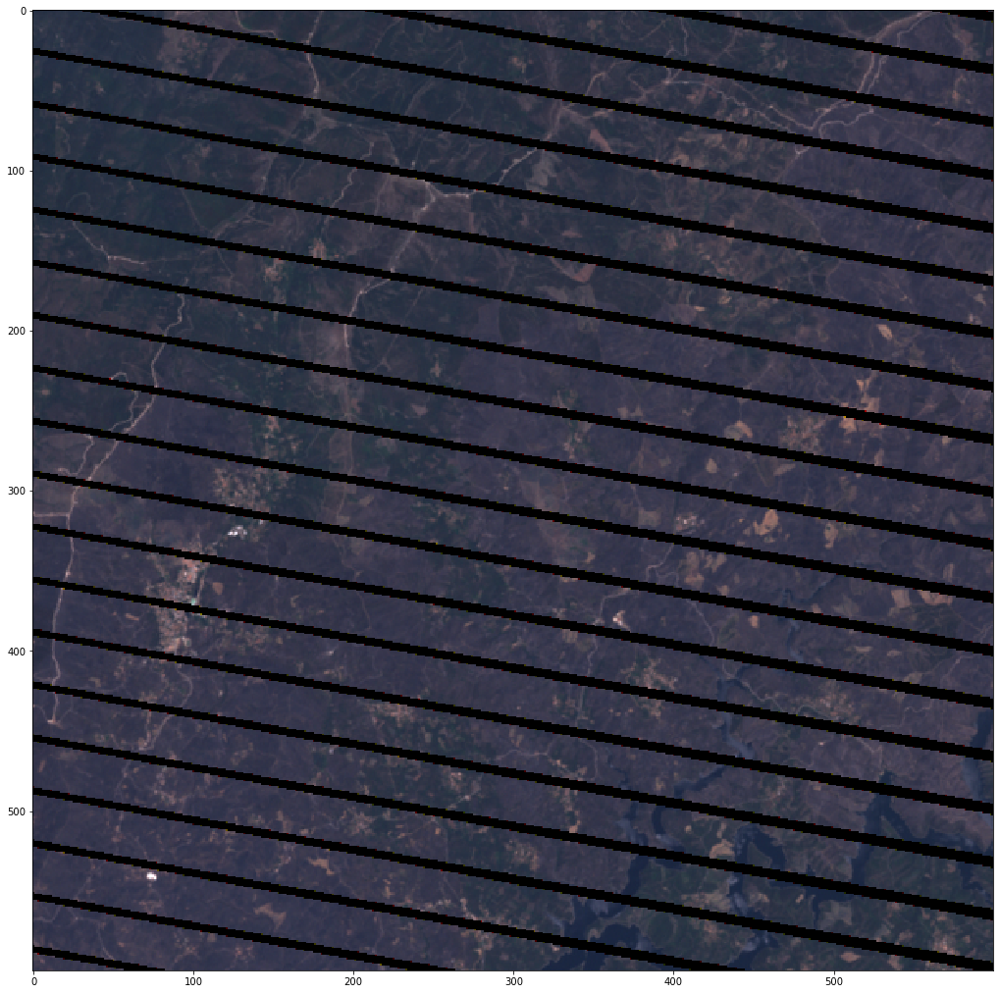



->>>>>>>>>>>>>>>>>> 1    LC08_L1TP_203034_20180814_20180828_01_T1       Image 2  of  39   

 
../../Satellite_img/1/LC08_L1TP_203034_20180814_20180828_01_T1\LC08_L1TP_203034_20180814_20180828_01_T1_B1.TIF
../../Satellite_img/1/LC08_L1TP_203034_20180814_20180828_01_T1\LC08_L1TP_203034_20180814_20180828_01_T1_B2.TIF
../../Satellite_img/1/LC08_L1TP_203034_20180814_20180828_01_T1\LC08_L1TP_203034_20180814_20180828_01_T1_B3.TIF
../../Satellite_img/1/LC08_L1TP_203034_20180814_20180828_01_T1\LC08_L1TP_203034_20180814_20180828_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7651, 'height': 7791, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 495285.0,
       0.0, -30.0, 4264515.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


1070 1670 3884 4484


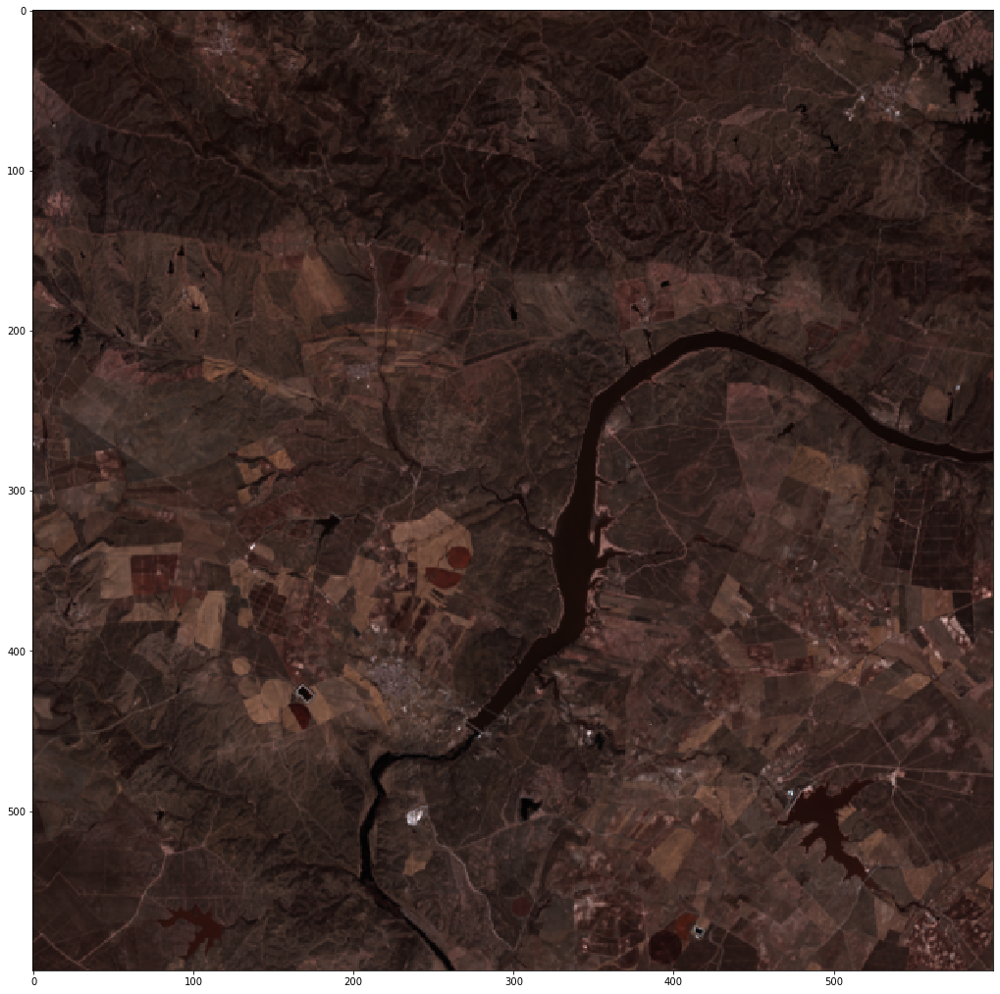



->>>>>>>>>>>>>>>>>> 1    LC08_L1TP_204034_20180805_20180814_01_T1       Image 3  of  39   

 
../../Satellite_img/1/LC08_L1TP_204034_20180805_20180814_01_T1\LC08_L1TP_204034_20180805_20180814_01_T1_B1.TIF
../../Satellite_img/1/LC08_L1TP_204034_20180805_20180814_01_T1\LC08_L1TP_204034_20180805_20180814_01_T1_B2.TIF
../../Satellite_img/1/LC08_L1TP_204034_20180805_20180814_01_T1\LC08_L1TP_204034_20180805_20180814_01_T1_B3.TIF
../../Satellite_img/1/LC08_L1TP_204034_20180805_20180814_01_T1\LC08_L1TP_204034_20180805_20180814_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7731, 'height': 7871, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 357885.0,
       0.0, -30.0, 4265115.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


5650 6250 3904 4504


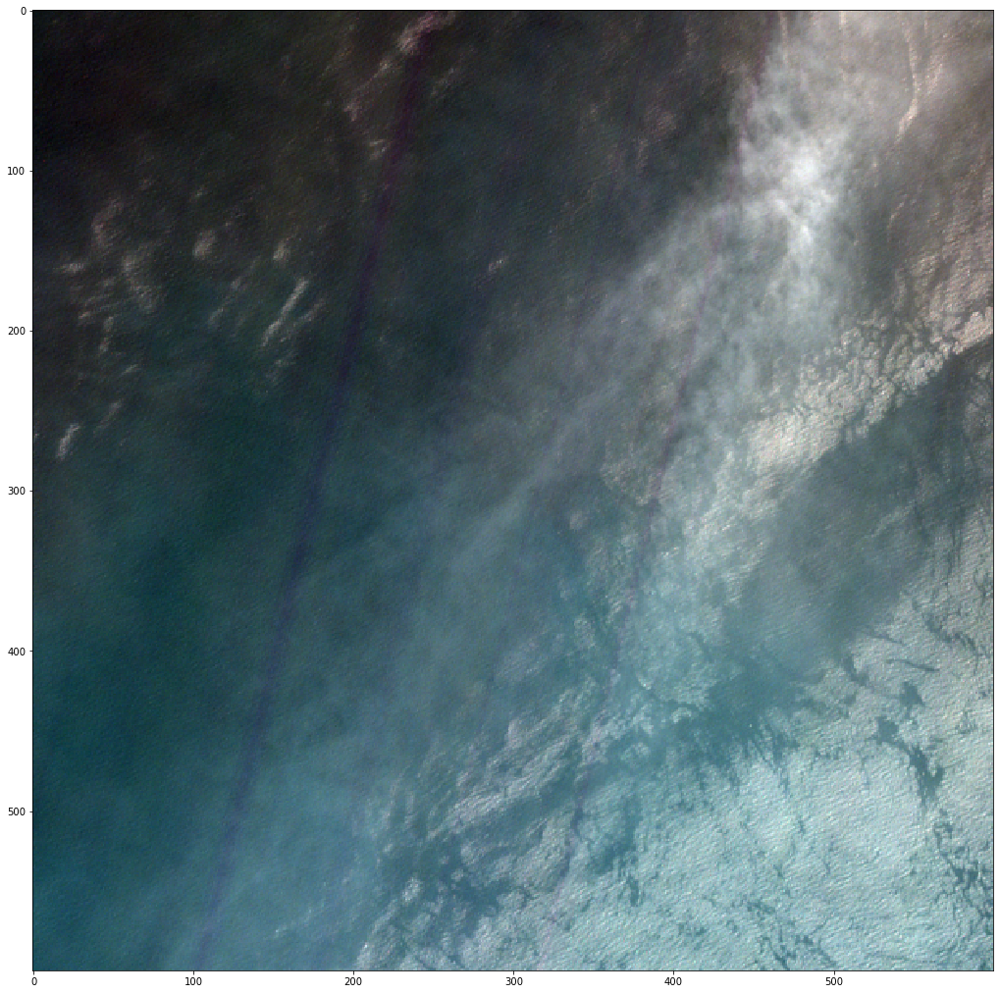



->>>>>>>>>>>>>>>>>> 1    LE07_L1TP_203034_20180806_20180901_01_T1       Image 4  of  39   

 
../../Satellite_img/1/LE07_L1TP_203034_20180806_20180901_01_T1\LE07_L1TP_203034_20180806_20180901_01_T1_B1.TIF
../../Satellite_img/1/LE07_L1TP_203034_20180806_20180901_01_T1\LE07_L1TP_203034_20180806_20180901_01_T1_B2.TIF
../../Satellite_img/1/LE07_L1TP_203034_20180806_20180901_01_T1\LE07_L1TP_203034_20180806_20180901_01_T1_B3.TIF
../../Satellite_img/1/LE07_L1TP_203034_20180806_20180901_01_T1\LE07_L1TP_203034_20180806_20180901_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8121, 'height': 7111, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 483585.0,
       0.0, -30.0, 4255815.0)}
1460 2060 3594 4194


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


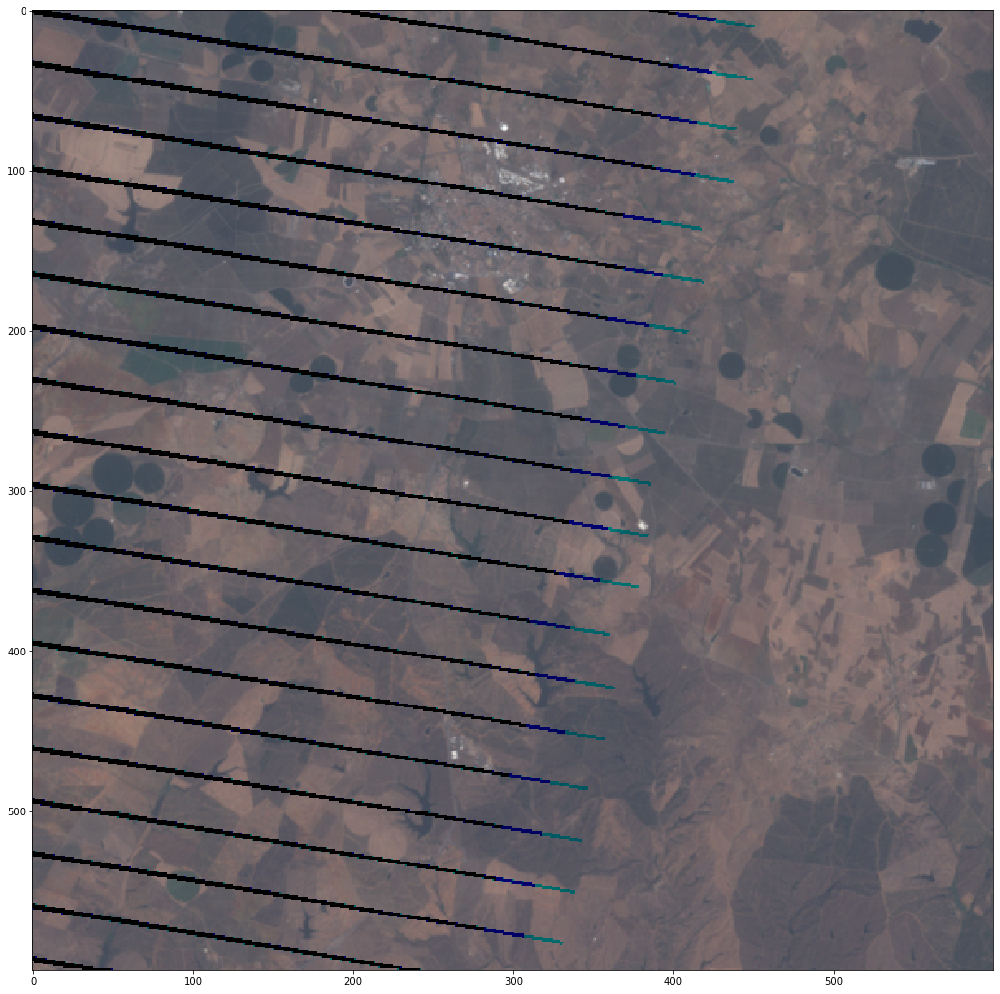



->>>>>>>>>>>>>>>>>> 1    LE07_L1TP_204034_20180813_20180908_01_T1       Image 5  of  39   

 
../../Satellite_img/1/LE07_L1TP_204034_20180813_20180908_01_T1\LE07_L1TP_204034_20180813_20180908_01_T1_B1.TIF
../../Satellite_img/1/LE07_L1TP_204034_20180813_20180908_01_T1\LE07_L1TP_204034_20180813_20180908_01_T1_B2.TIF
../../Satellite_img/1/LE07_L1TP_204034_20180813_20180908_01_T1\LE07_L1TP_204034_20180813_20180908_01_T1_B3.TIF
../../Satellite_img/1/LE07_L1TP_204034_20180813_20180908_01_T1\LE07_L1TP_204034_20180813_20180908_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8191, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 345285.0,
       0.0, -30.0, 4256115.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


6070 6670 3604 4204


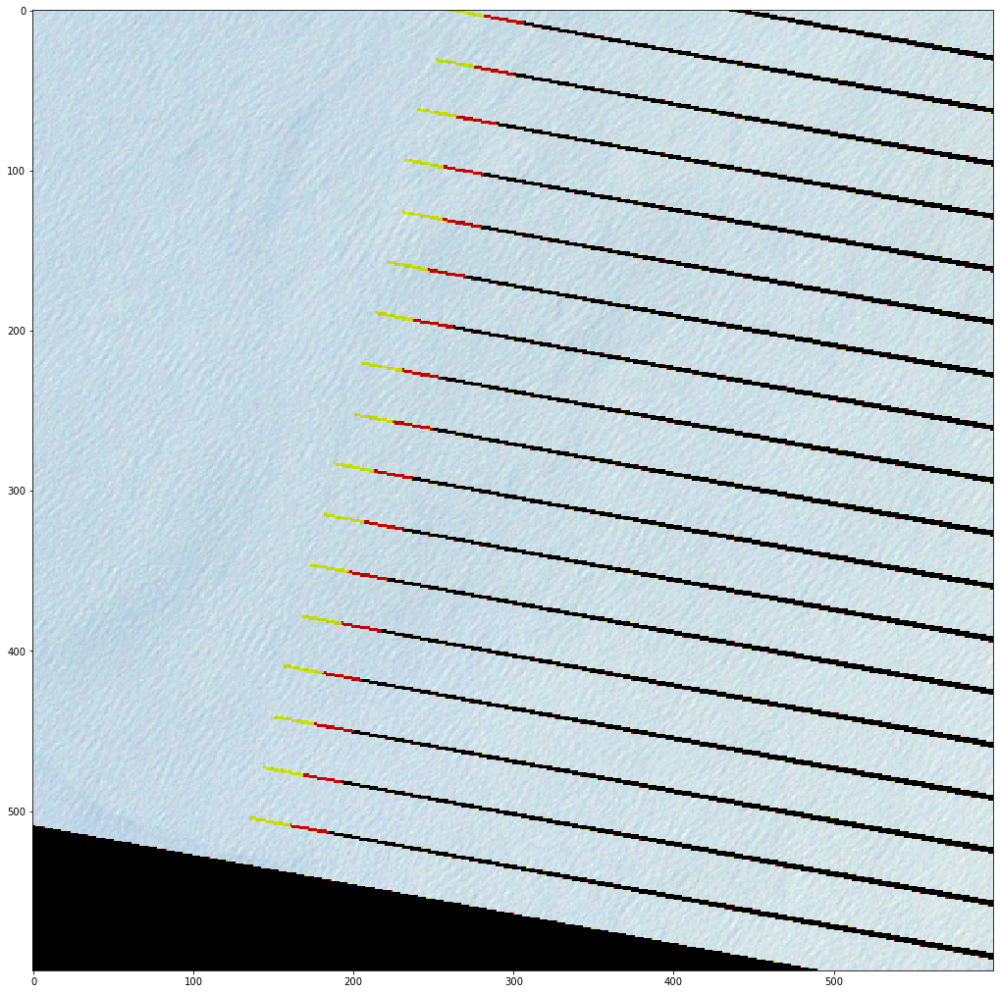



->>>>>>>>>>>>>>>>>> 10    LC08_L1TP_203032_20171014_20171024_01_T1       Image 6  of  39   

 
../../Satellite_img/10/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B1.TIF
../../Satellite_img/10/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B2.TIF
../../Satellite_img/10/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B3.TIF
../../Satellite_img/10/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7631, 'height': 7771, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 563085.0,
       0.0, -30.0, 4582815.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


345 945 3520 4120


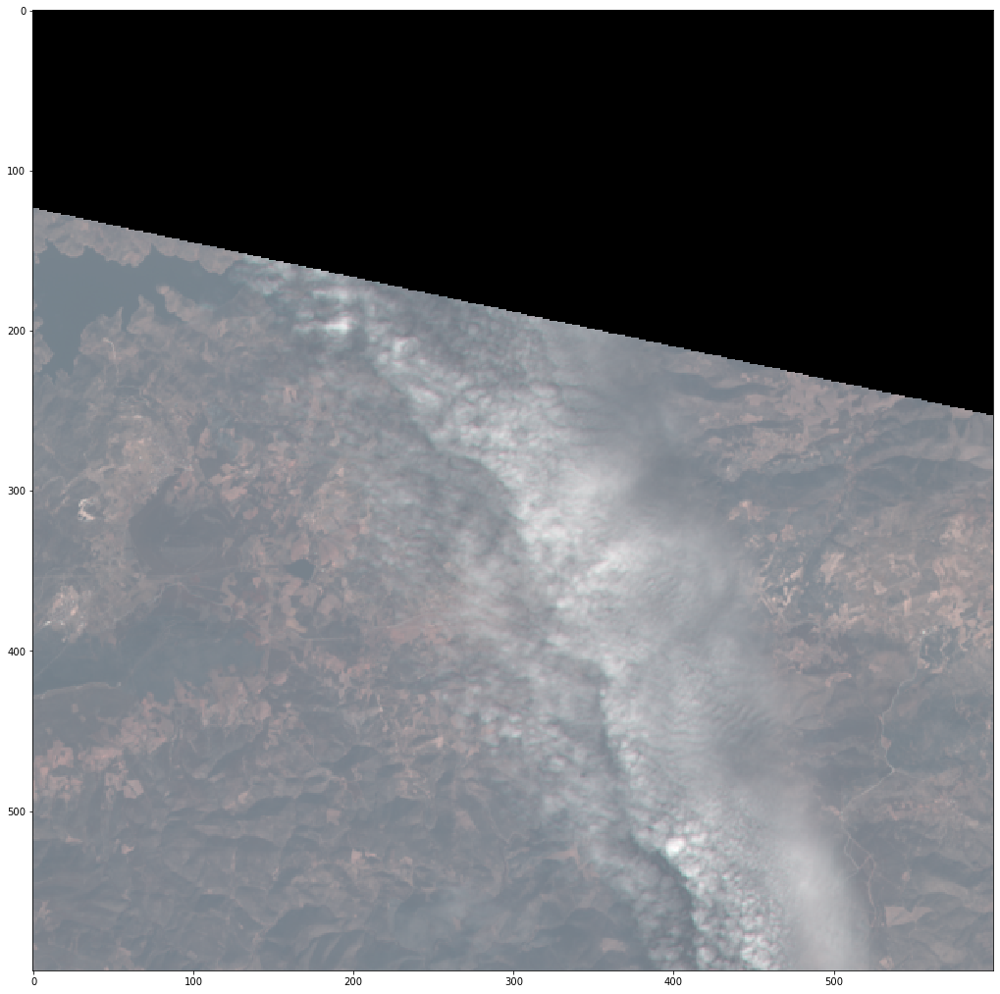



->>>>>>>>>>>>>>>>>> 10    LE07_L1TP_204032_20171013_20171109_01_T1       Image 7  of  39   

 
../../Satellite_img/10/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/10/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/10/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/10/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


5095 5695 3190 3790


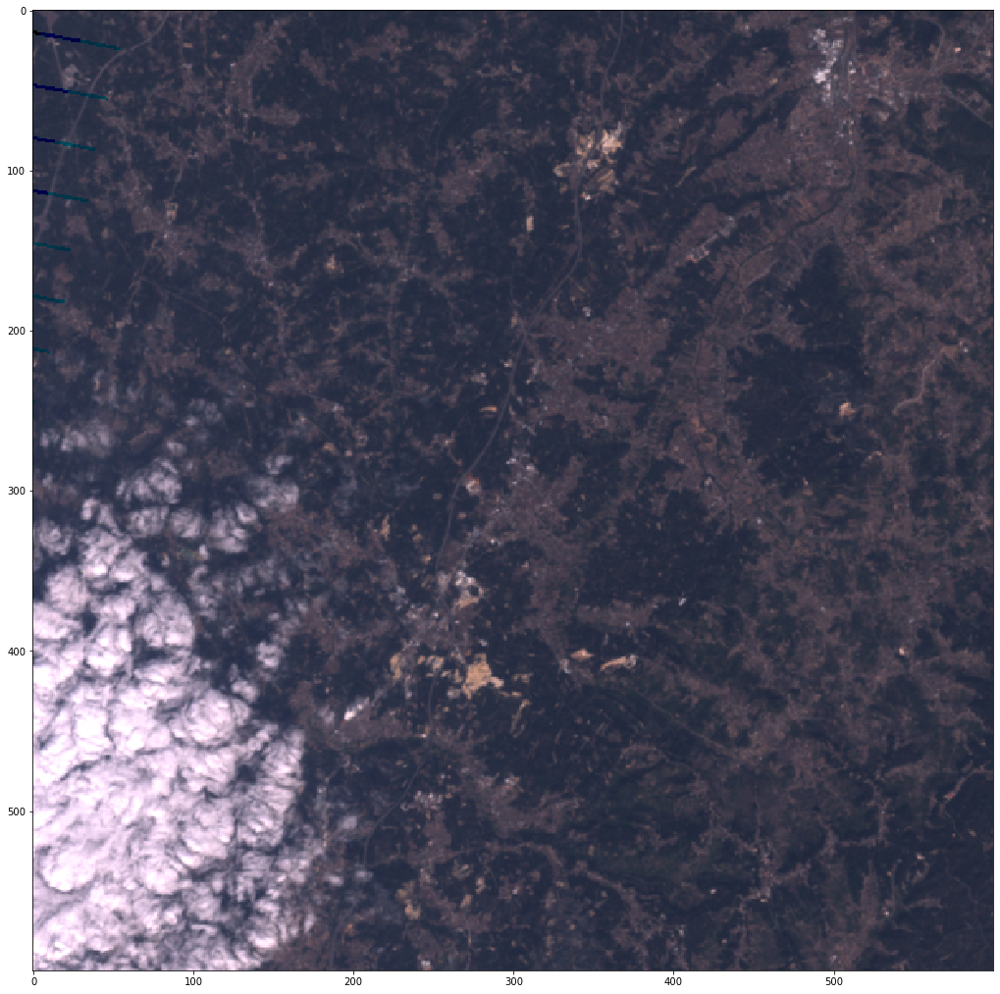



->>>>>>>>>>>>>>>>>> 11    LE07_L1TP_204032_20171013_20171109_01_T1       Image 8  of  39   

 
../../Satellite_img/11/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/11/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/11/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/11/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


4709 5309 3409 4009


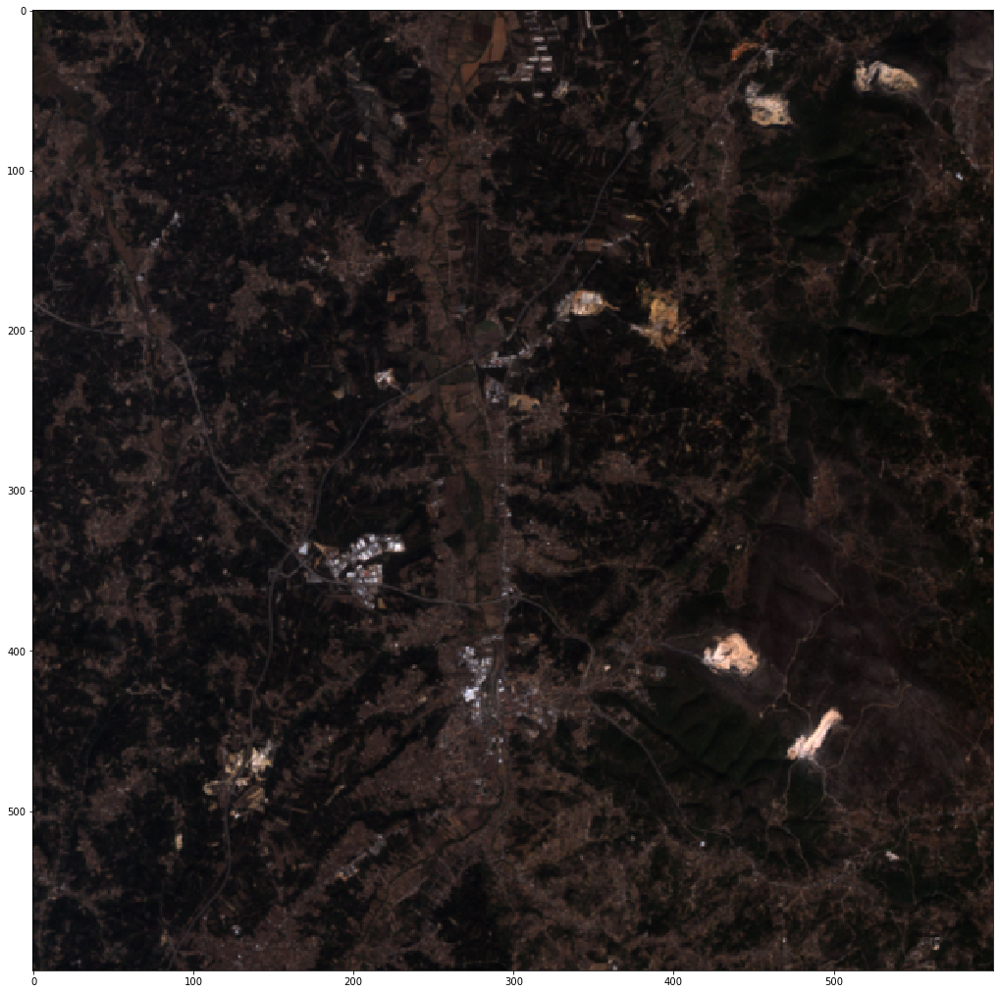



->>>>>>>>>>>>>>>>>> 12    LE07_L1TP_204032_20171013_20171109_01_T1       Image 9  of  39   

 
../../Satellite_img/12/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/12/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/12/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/12/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


4516 5116 3074 3674


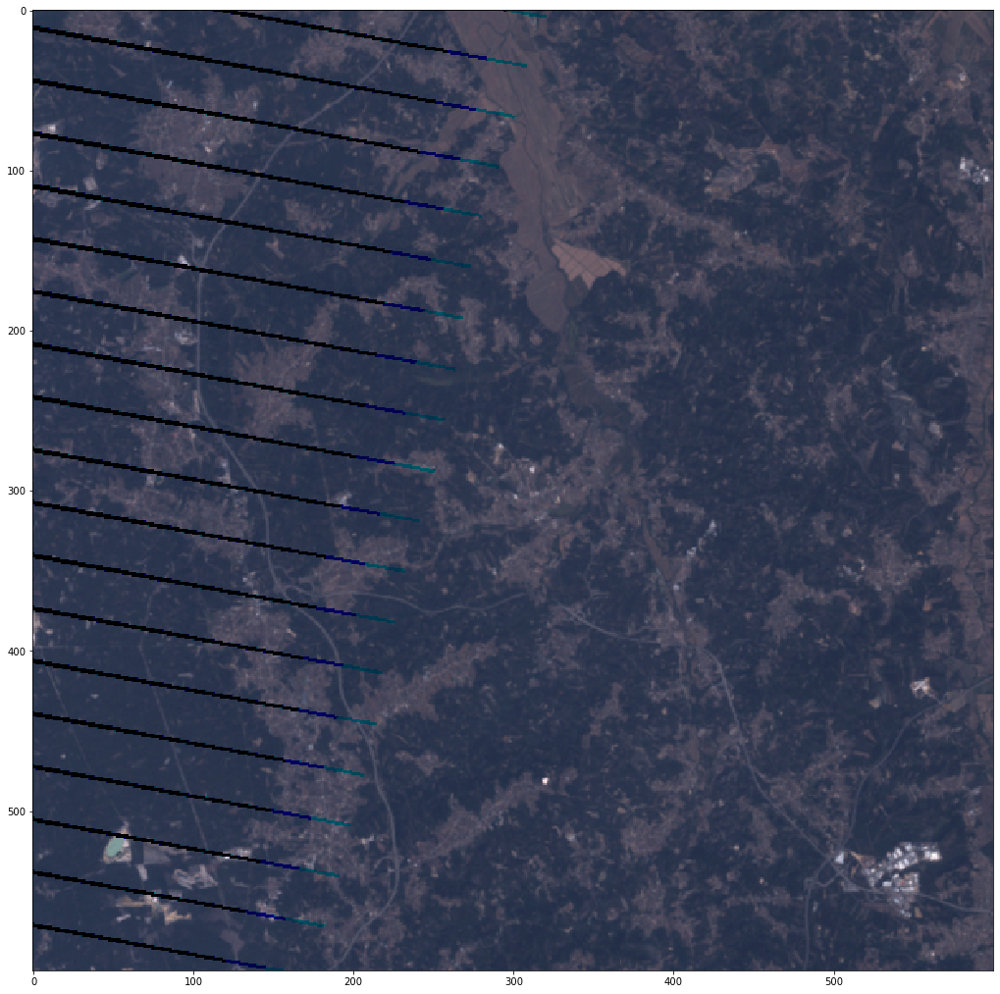



->>>>>>>>>>>>>>>>>> 13    LE07_L1TP_204032_20171013_20171109_01_T1       Image 10  of  39   

 
../../Satellite_img/13/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/13/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/13/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/13/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
4935 5535 2613 3213


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


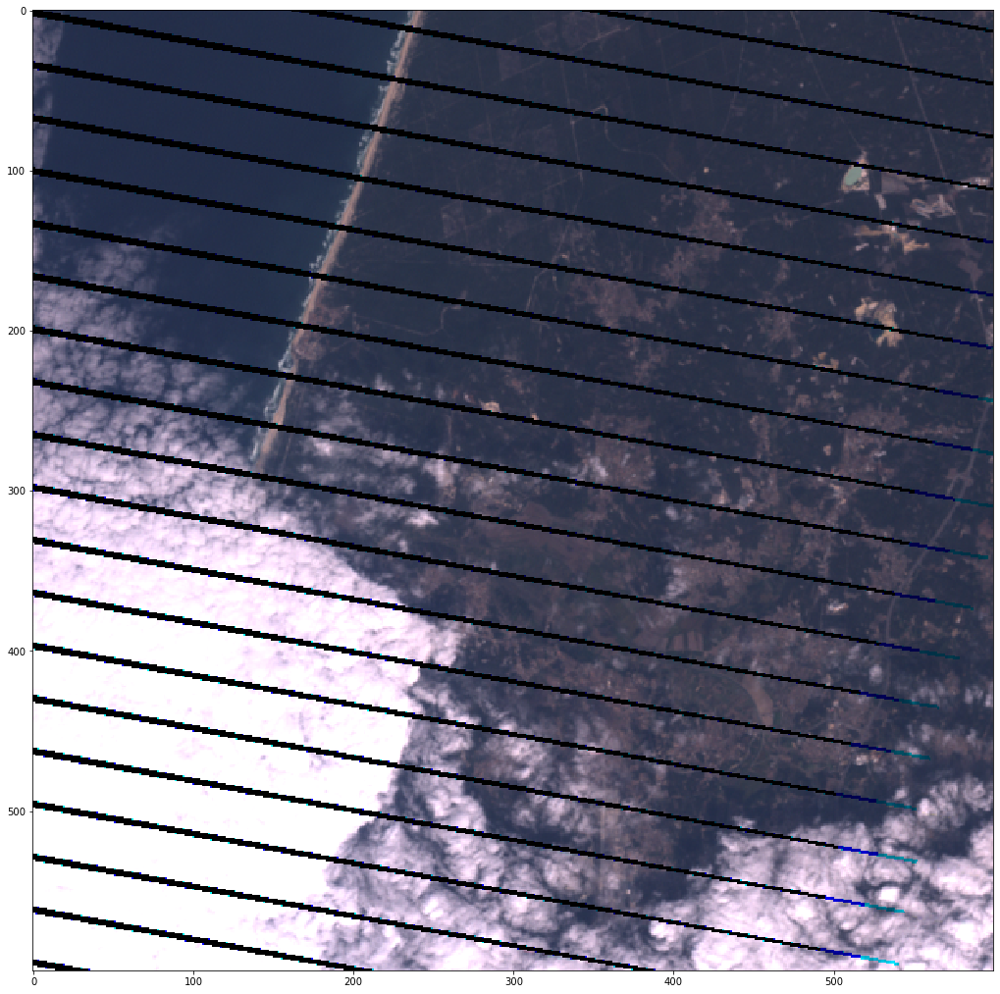



->>>>>>>>>>>>>>>>>> 14    LC08_L1TP_203032_20171014_20171024_01_T1       Image 11  of  39   

 
../../Satellite_img/14/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B1.TIF
../../Satellite_img/14/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B2.TIF
../../Satellite_img/14/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B3.TIF
../../Satellite_img/14/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7631, 'height': 7771, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 563085.0,
       0.0, -30.0, 4582815.0)}
463 1063 3856 4456


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


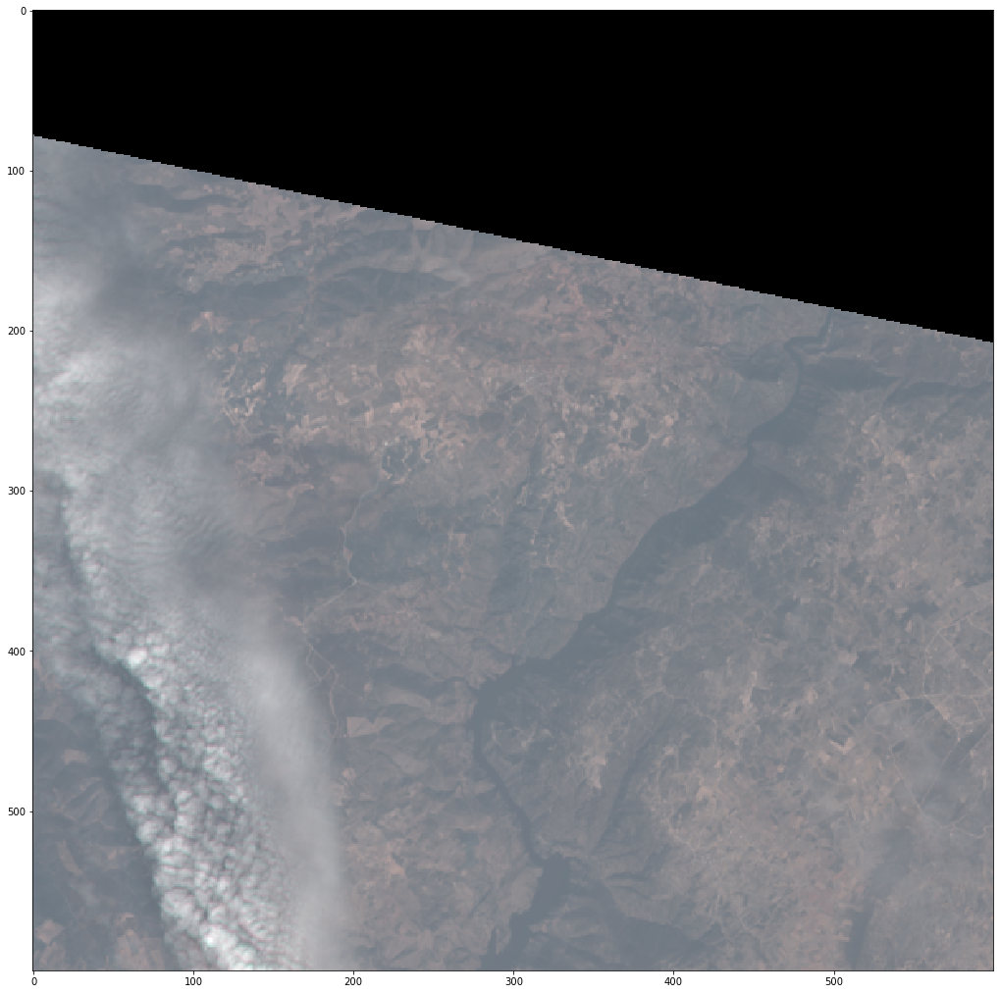



->>>>>>>>>>>>>>>>>> 14    LE07_L1TP_204032_20171013_20171109_01_T1       Image 12  of  39   

 
../../Satellite_img/14/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/14/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/14/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/14/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
5213 5813 3526 4126


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


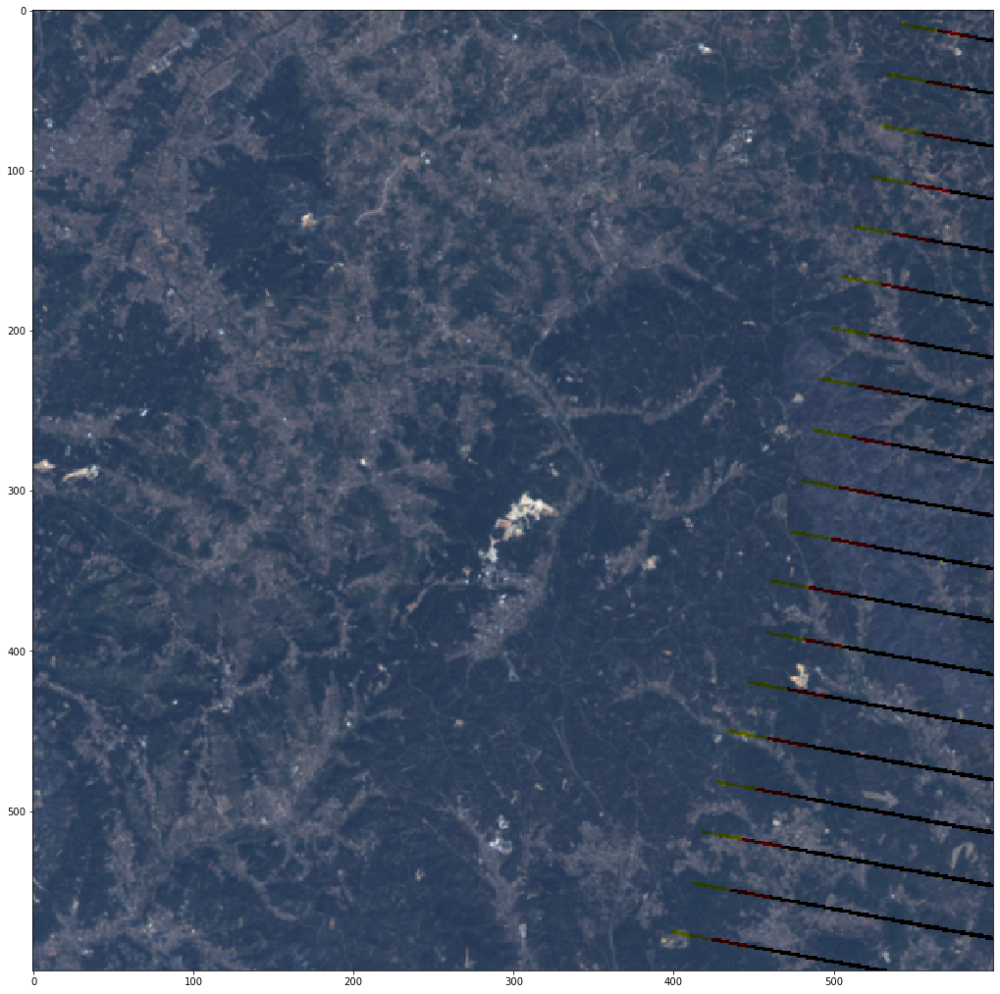



->>>>>>>>>>>>>>>>>> 15    LE07_L1TP_204032_20171013_20171109_01_T1       Image 13  of  39   

 
../../Satellite_img/15/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/15/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/15/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/15/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
4033 4633 1387 1987


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


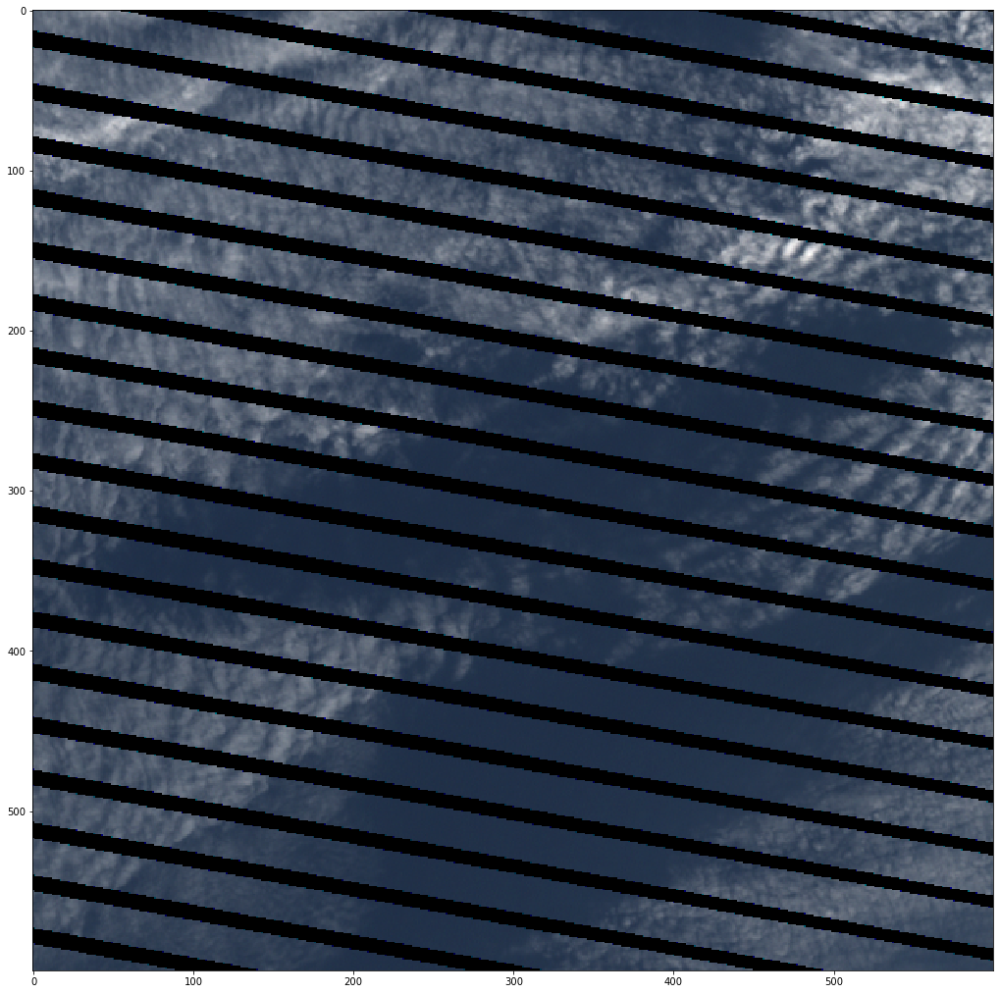



->>>>>>>>>>>>>>>>>> 16    LC08_L1TP_203032_20171014_20171024_01_T1       Image 14  of  39   

 
../../Satellite_img/16/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B1.TIF
../../Satellite_img/16/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B2.TIF
../../Satellite_img/16/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B3.TIF
../../Satellite_img/16/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7631, 'height': 7771, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 563085.0,
       0.0, -30.0, 4582815.0)}
164 764 5592 6192


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\rasterio\plot.py:328: RuntimeWarning: invalid value encountered in true_divide
  band_normed = (band - imin) / (imax - imin)


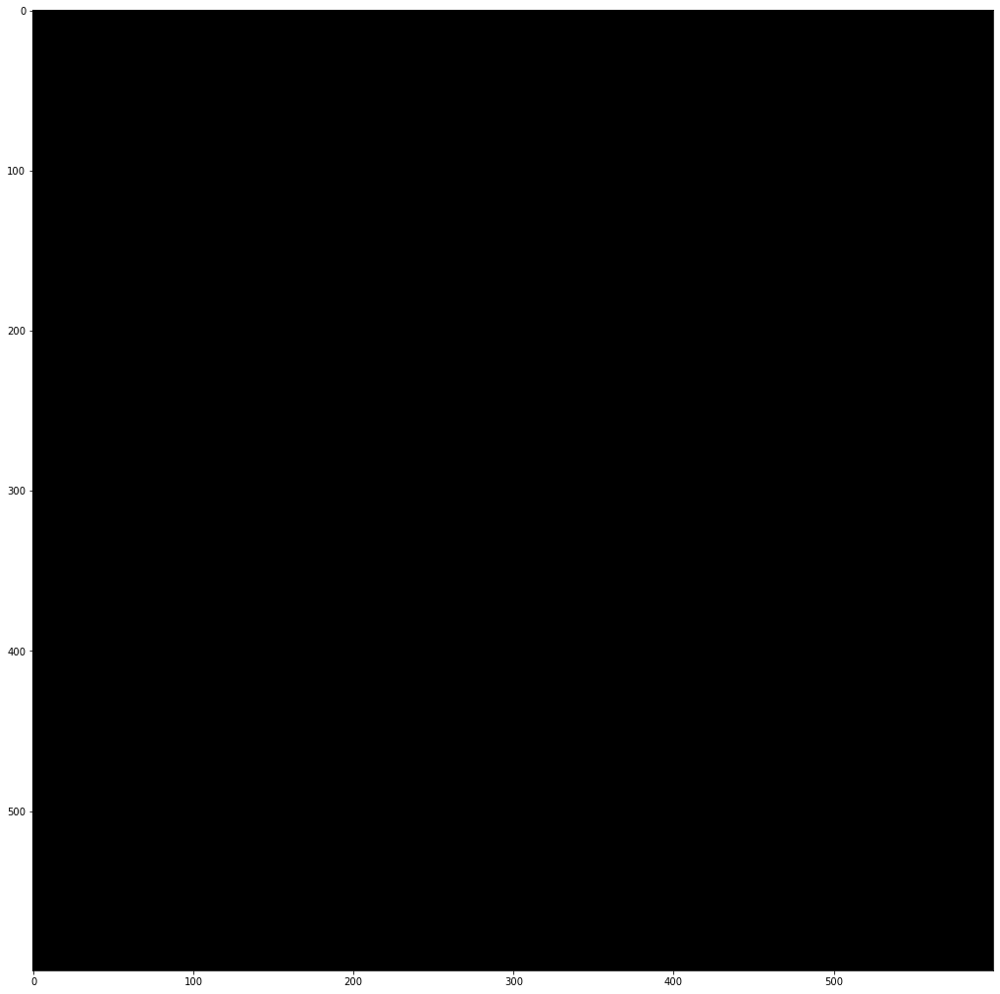



->>>>>>>>>>>>>>>>>> 16    LC08_L1TP_203033_20171014_20171024_01_T1       Image 15  of  39   

 
../../Satellite_img/16/LC08_L1TP_203033_20171014_20171024_01_T1\LC08_L1TP_203033_20171014_20171024_01_T1_B1.TIF
../../Satellite_img/16/LC08_L1TP_203033_20171014_20171024_01_T1\LC08_L1TP_203033_20171014_20171024_01_T1_B2.TIF
../../Satellite_img/16/LC08_L1TP_203033_20171014_20171024_01_T1\LC08_L1TP_203033_20171014_20171024_01_T1_B3.TIF
../../Satellite_img/16/LC08_L1TP_203033_20171014_20171024_01_T1\LC08_L1TP_203033_20171014_20171024_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7641, 'height': 7771, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 527985.0,
       0.0, -30.0, 4423515.0)}
1334 1934 282 882


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\rasterio\plot.py:328: RuntimeWarning: invalid value encountered in true_divide
  band_normed = (band - imin) / (imax - imin)


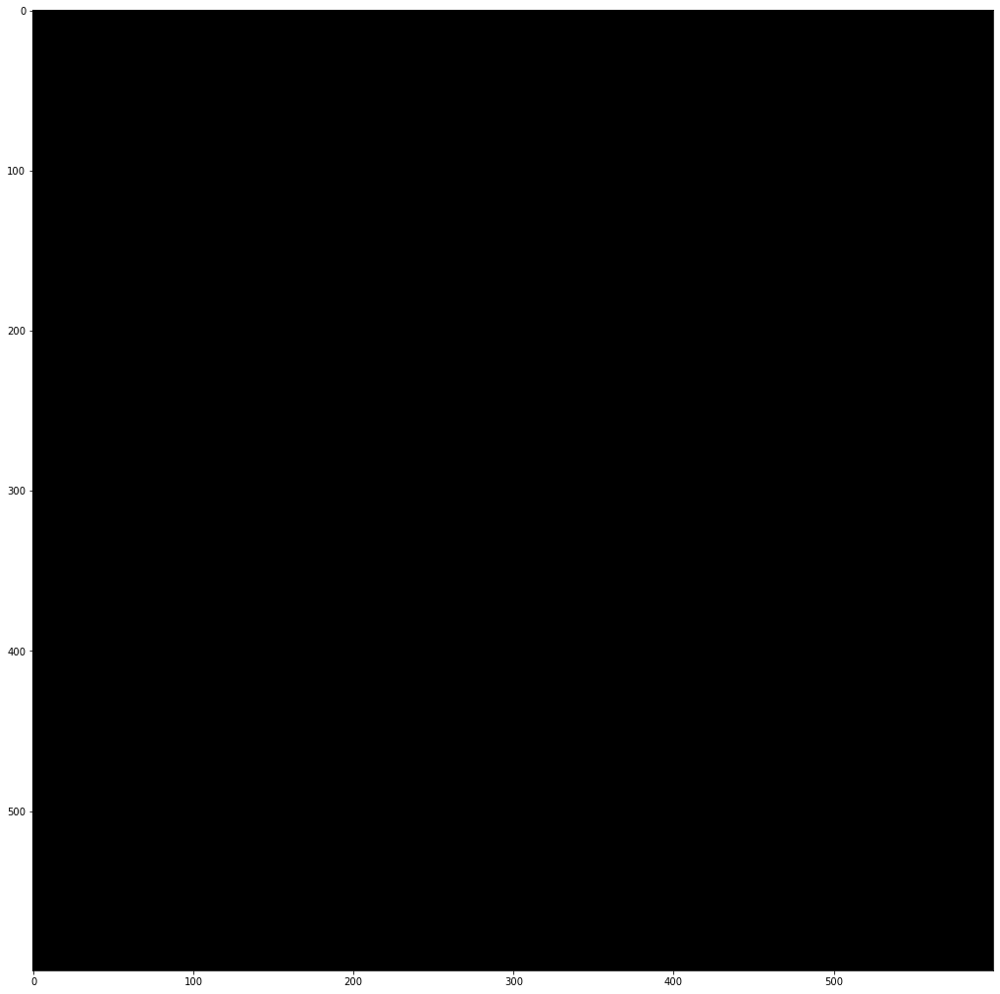



->>>>>>>>>>>>>>>>>> 16    LE07_L1TP_204032_20171013_20171109_01_T1       Image 16  of  39   

 
../../Satellite_img/16/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/16/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/16/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/16/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
4914 5514 5262 5862


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


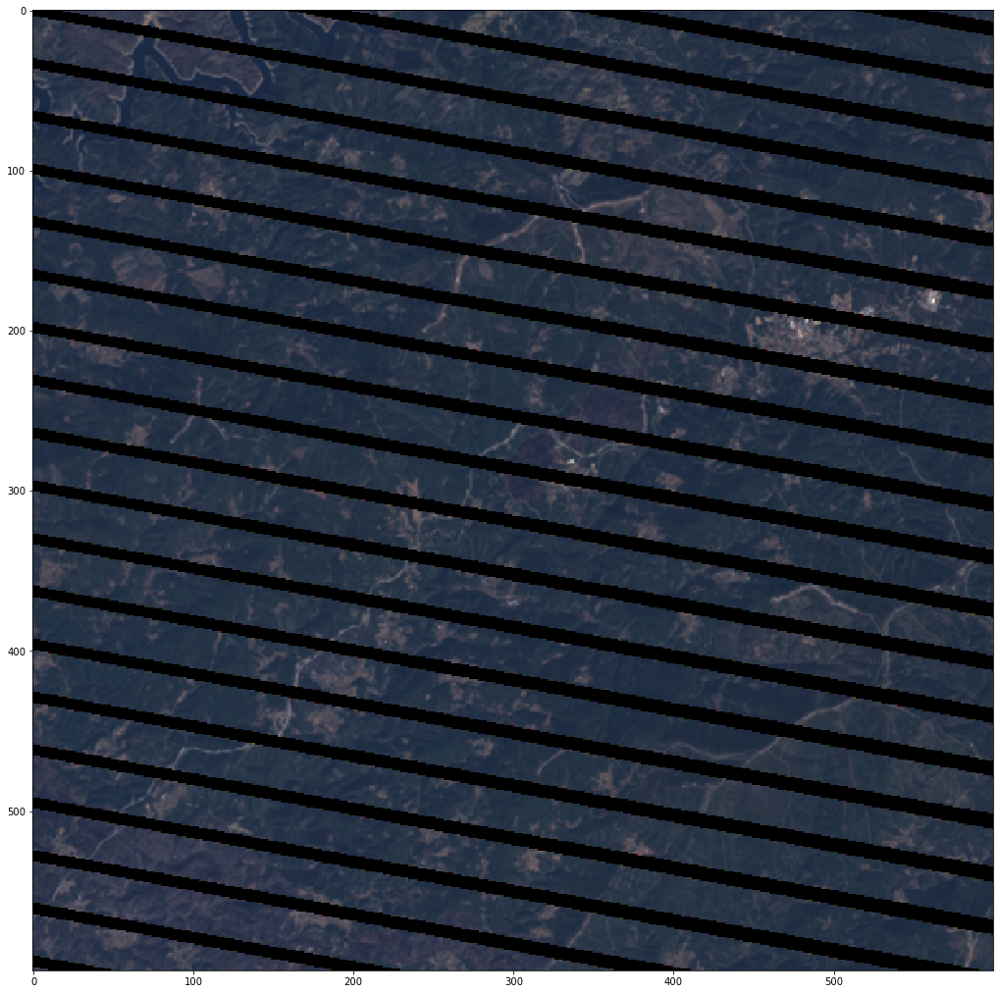



->>>>>>>>>>>>>>>>>> 17    LE07_L1TP_204031_20171013_20171110_01_T1       Image 17  of  39   

 
../../Satellite_img/17/LE07_L1TP_204031_20171013_20171110_01_T1\LE07_L1TP_204031_20171013_20171110_01_T1_B1.TIF
../../Satellite_img/17/LE07_L1TP_204031_20171013_20171110_01_T1\LE07_L1TP_204031_20171013_20171110_01_T1_B2.TIF
../../Satellite_img/17/LE07_L1TP_204031_20171013_20171110_01_T1\LE07_L1TP_204031_20171013_20171110_01_T1_B3.TIF
../../Satellite_img/17/LE07_L1TP_204031_20171013_20171110_01_T1\LE07_L1TP_204031_20171013_20171110_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8171, 'height': 7191, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 458385.0,
       0.0, -30.0, 4731915.0)}
2622 3222 2268 2868


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


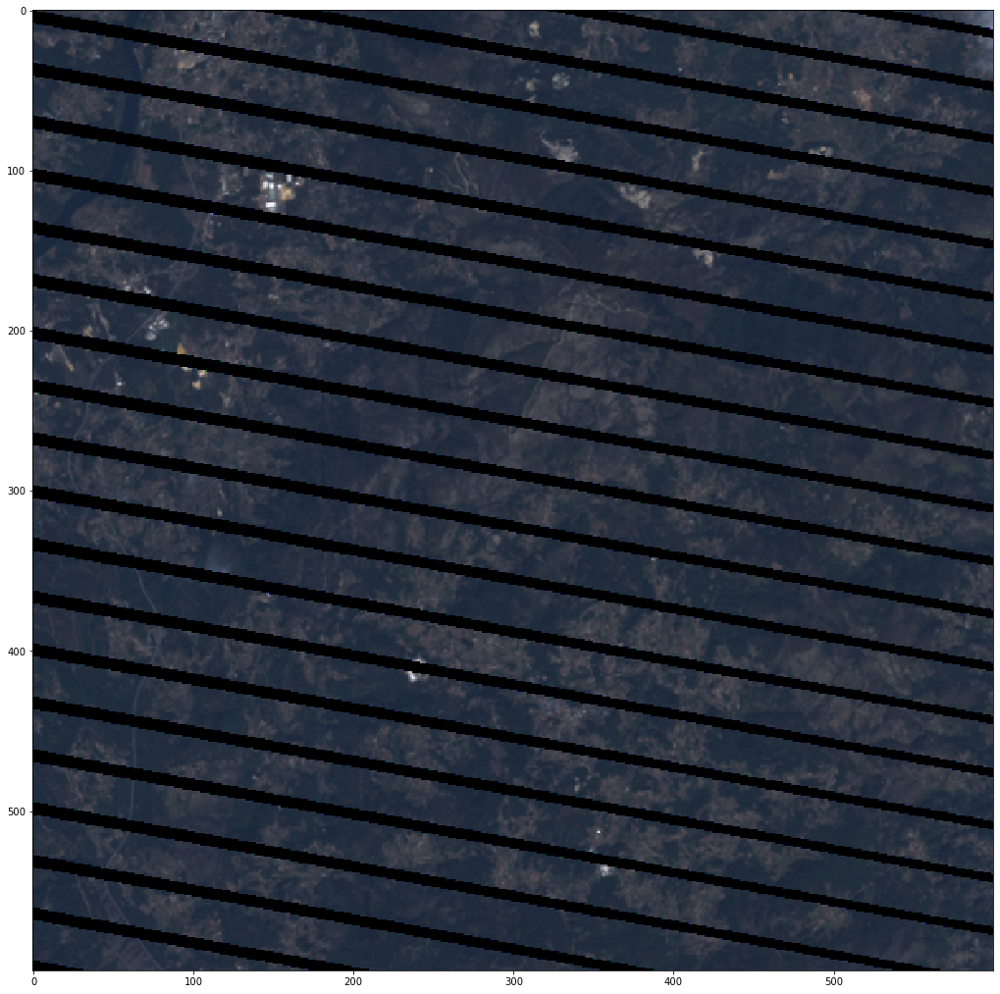



->>>>>>>>>>>>>>>>>> 18    LE07_L1TP_204032_20171013_20171109_01_T1       Image 18  of  39   

 
../../Satellite_img/18/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/18/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/18/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/18/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
4798 5398 3046 3646


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


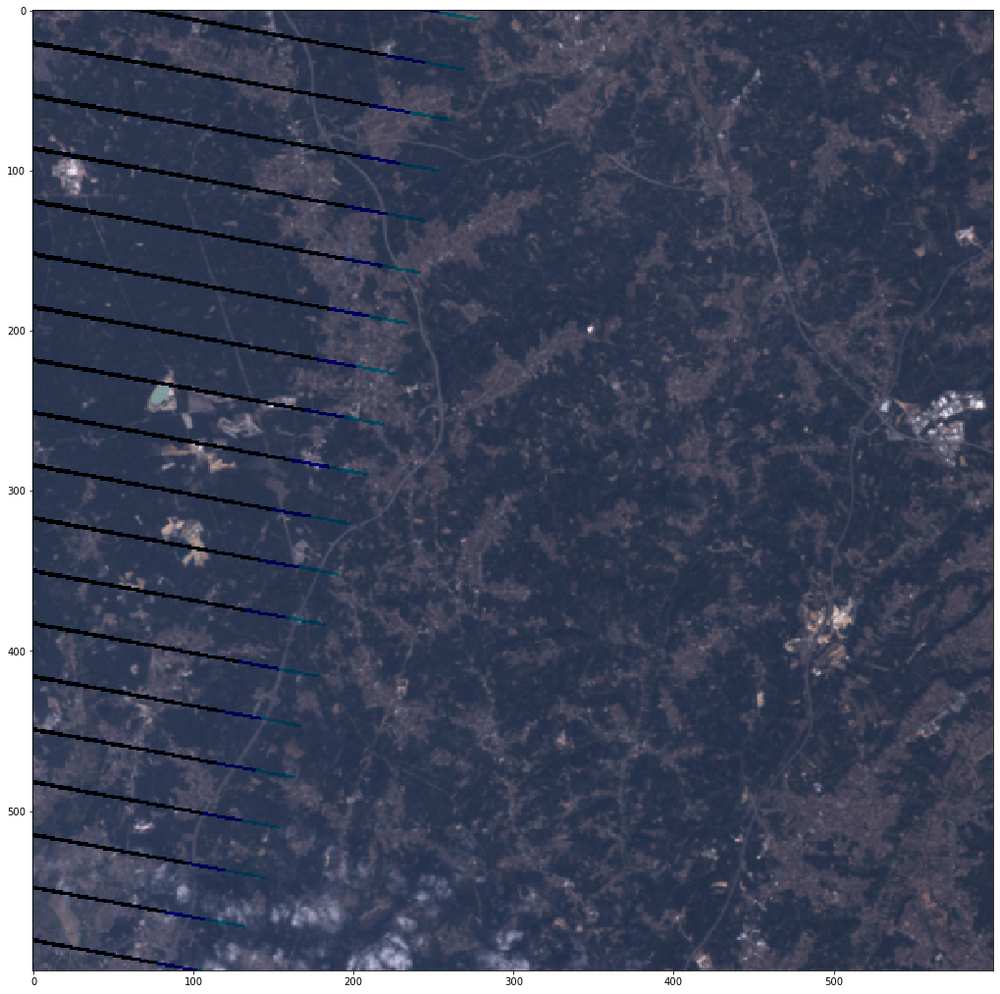



->>>>>>>>>>>>>>>>>> 19    LE07_L1TP_204032_20171013_20171109_01_T1       Image 19  of  39   

 
../../Satellite_img/19/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/19/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/19/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/19/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
2764 3364 3733 4333


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


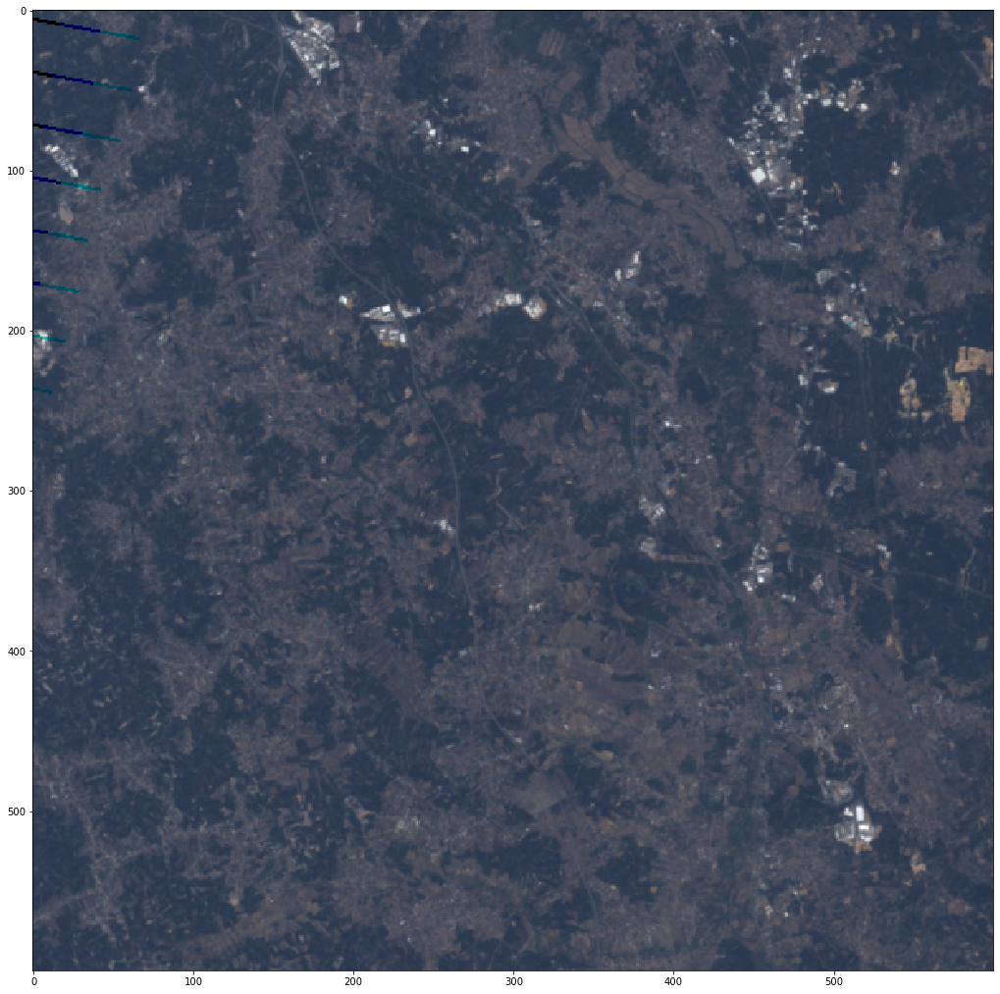



->>>>>>>>>>>>>>>>>> 2    LE07_L1TP_204032_20171013_20171109_01_T1       Image 20  of  39   

 
../../Satellite_img/2/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/2/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/2/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/2/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
4477 5077 4097 4697


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


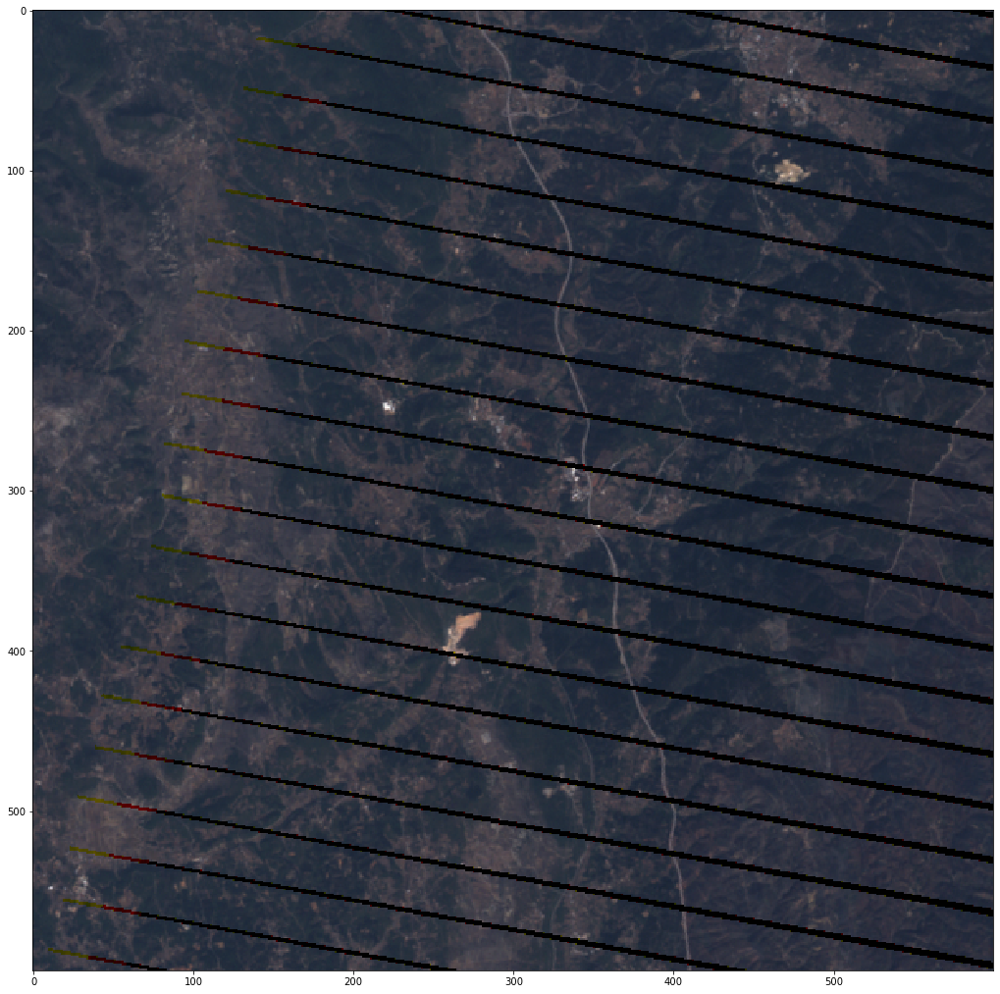



->>>>>>>>>>>>>>>>>> 20    LE07_L1TP_204032_20171013_20171109_01_T1       Image 21  of  39   

 
../../Satellite_img/20/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/20/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/20/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/20/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
2913 3513 3366 3966


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


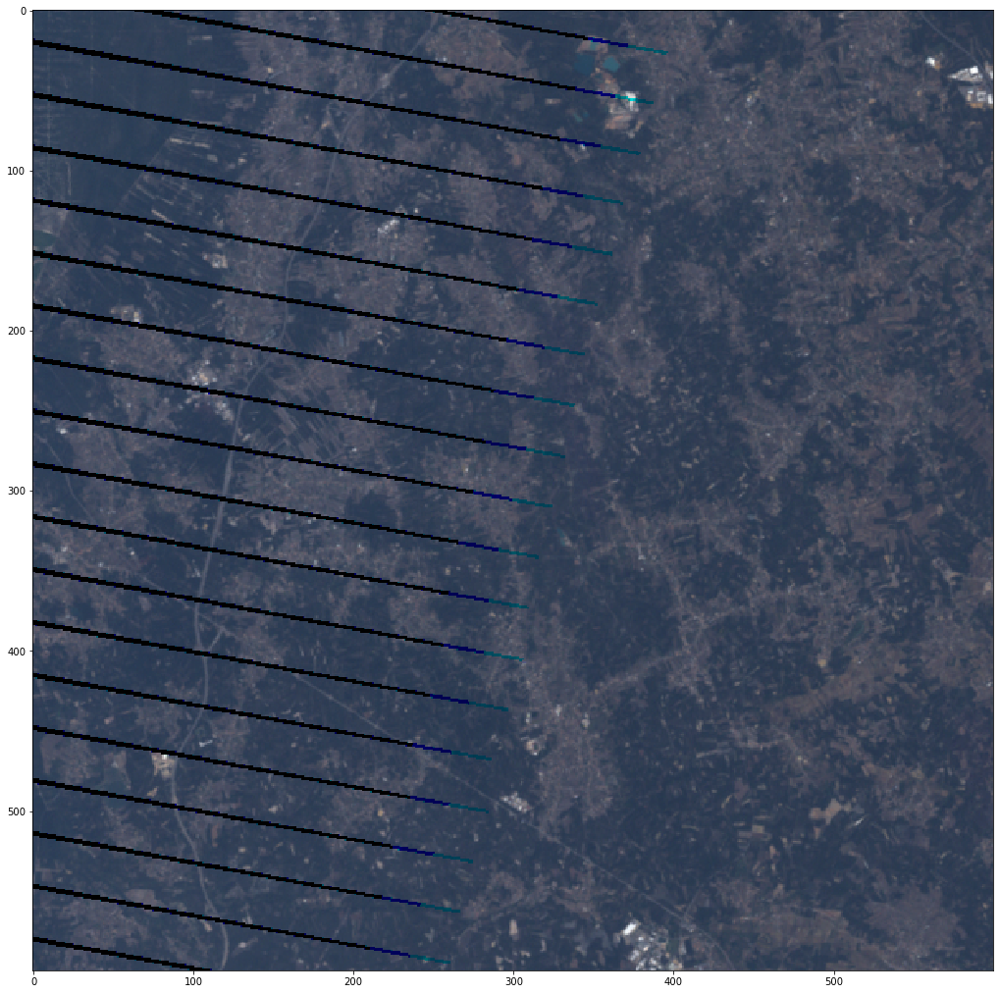



->>>>>>>>>>>>>>>>>> 21    LE07_L1TP_204032_20171013_20171109_01_T1       Image 22  of  39   

 
../../Satellite_img/21/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/21/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/21/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/21/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
3101 3701 2934 3534


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


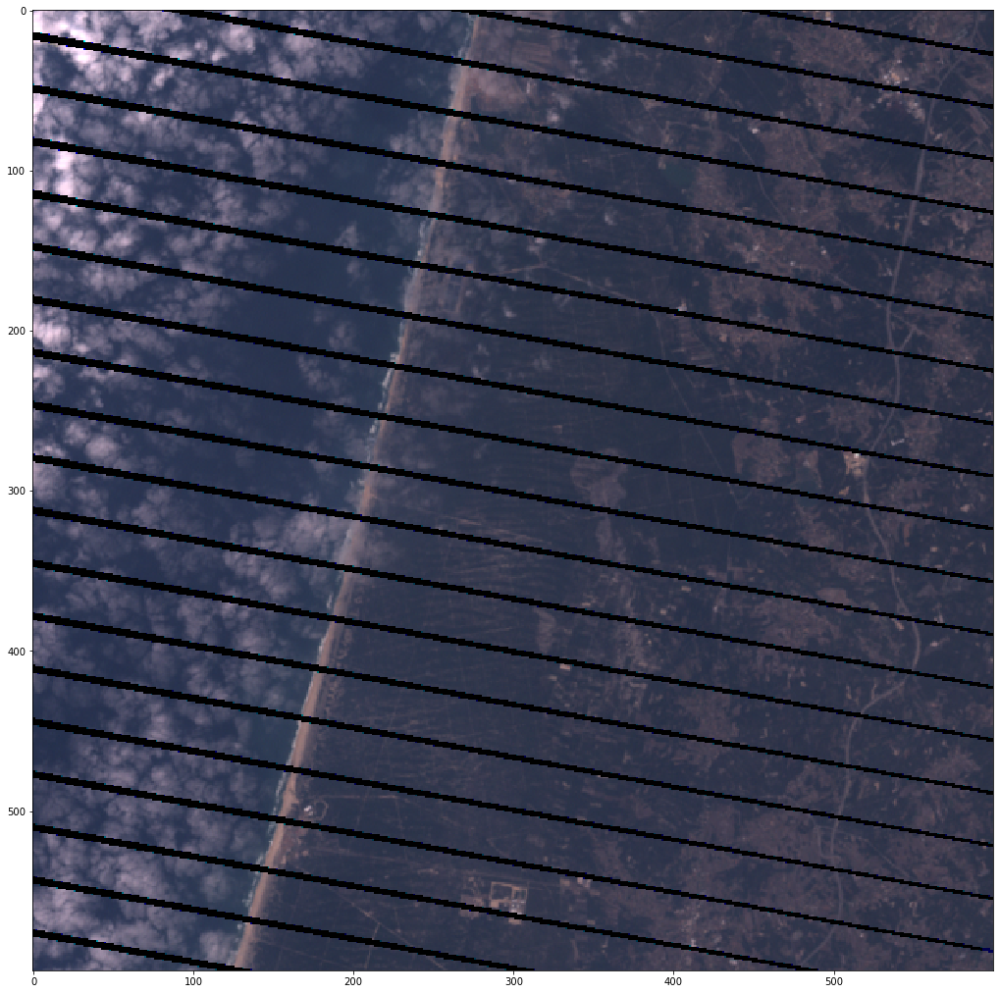



->>>>>>>>>>>>>>>>>> 22    LE07_L1TP_204032_20171013_20171109_01_T1       Image 23  of  39   

 
../../Satellite_img/22/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/22/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/22/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/22/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
3240 3840 2502 3102


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


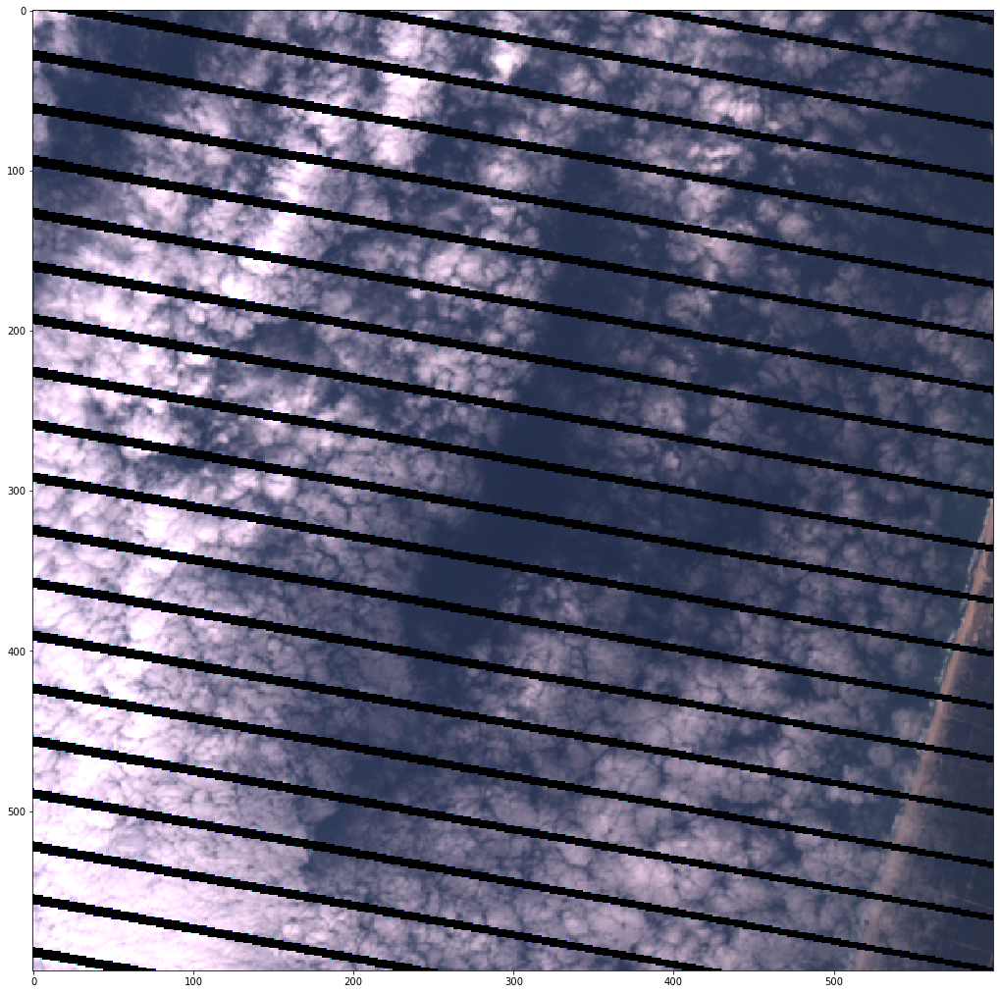



->>>>>>>>>>>>>>>>>> 23    LE07_L1TP_204032_20171013_20171109_01_T1       Image 24  of  39   

 
../../Satellite_img/23/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/23/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/23/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/23/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
3287 3887 2316 2916


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


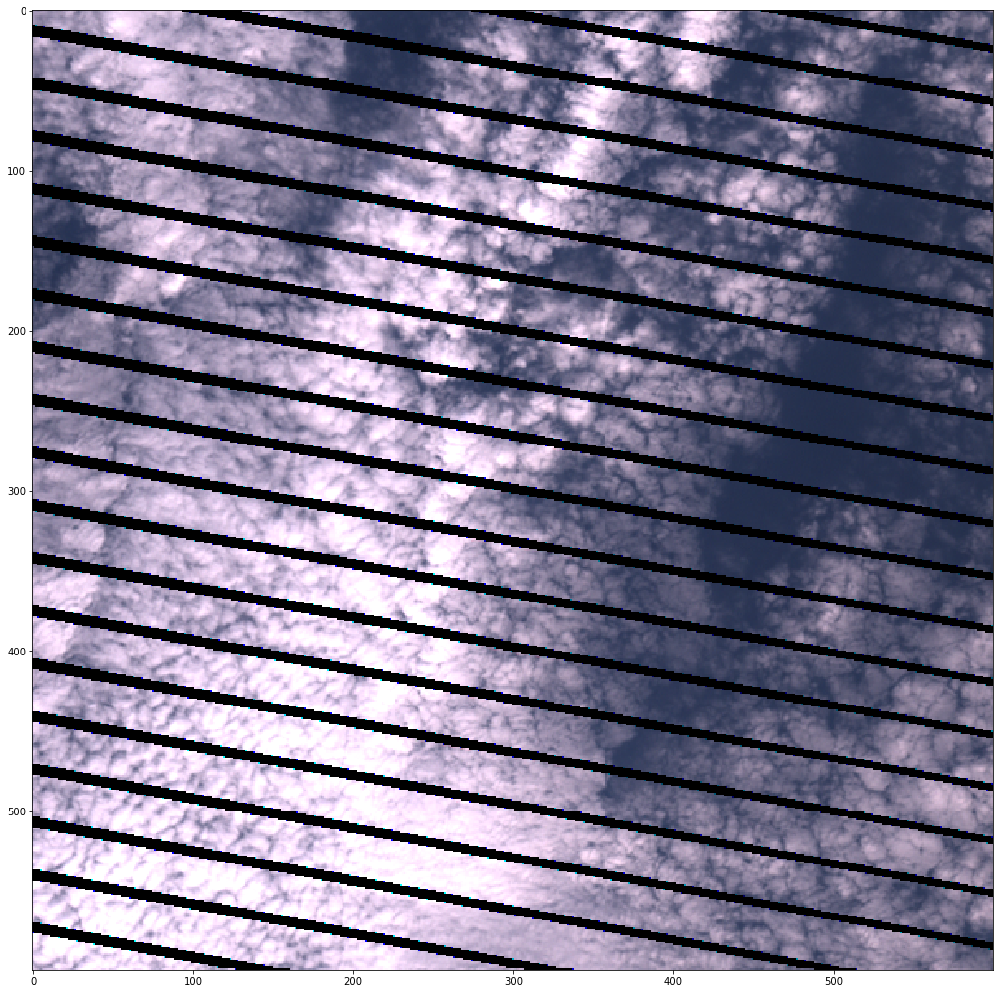



->>>>>>>>>>>>>>>>>> 24    LC08_L1TP_203032_20171014_20171024_01_T1       Image 25  of  39   

 
../../Satellite_img/24/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B1.TIF
../../Satellite_img/24/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B2.TIF
../../Satellite_img/24/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B3.TIF
../../Satellite_img/24/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7631, 'height': 7771, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 563085.0,
       0.0, -30.0, 4582815.0)}
424 1024 3249 3849


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


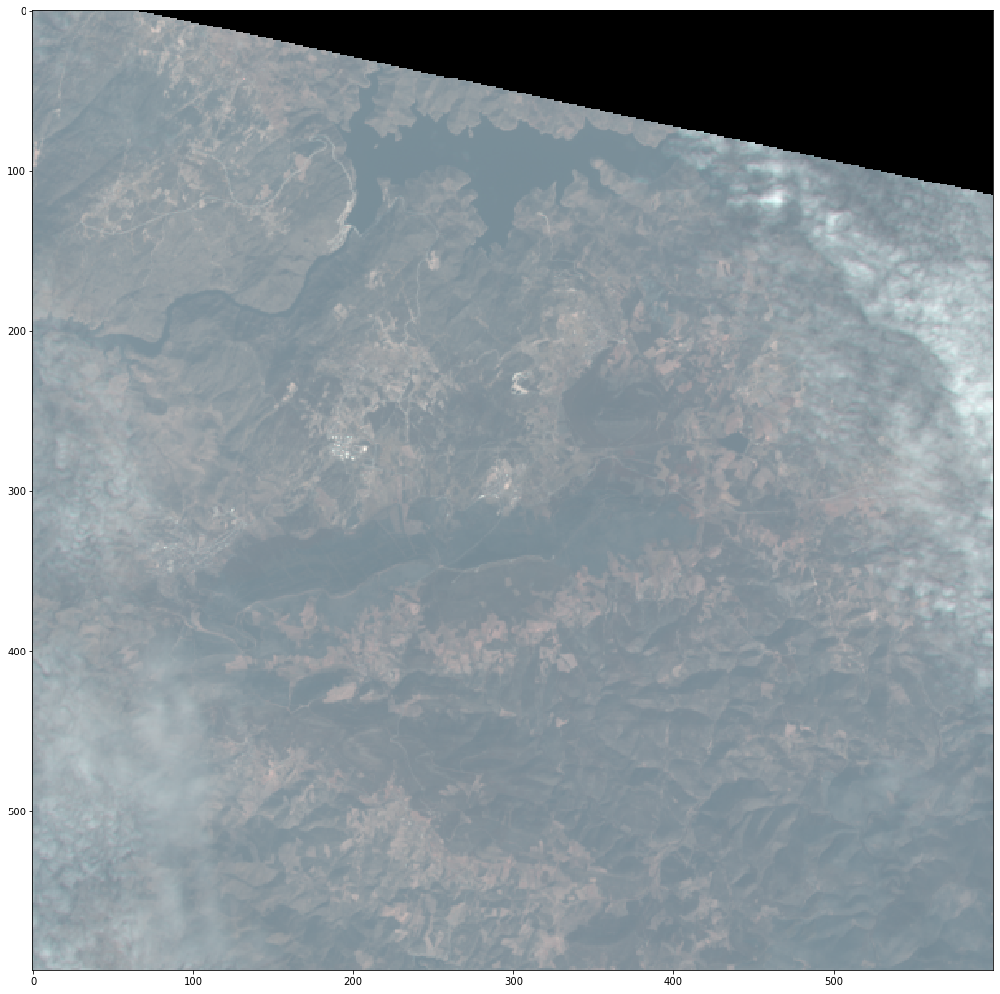



->>>>>>>>>>>>>>>>>> 24    LE07_L1TP_204032_20171013_20171109_01_T1       Image 26  of  39   

 
../../Satellite_img/24/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/24/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/24/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/24/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
5174 5774 2919 3519


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


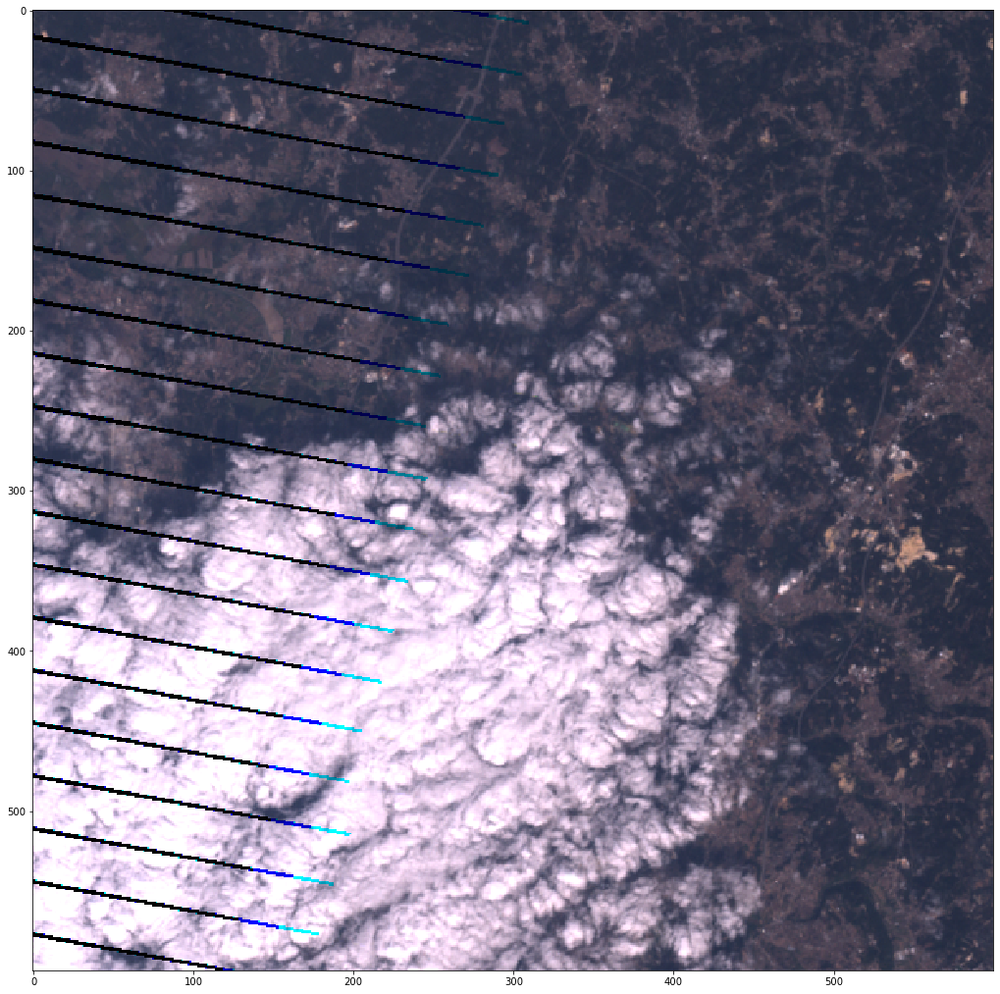



->>>>>>>>>>>>>>>>>> 3    LC08_L1TP_203032_20171014_20171024_01_T1       Image 27  of  39   

 
../../Satellite_img/3/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B1.TIF
../../Satellite_img/3/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B2.TIF
../../Satellite_img/3/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B3.TIF
../../Satellite_img/3/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7631, 'height': 7771, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 563085.0,
       0.0, -30.0, 4582815.0)}
582 1182 4666 5266


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


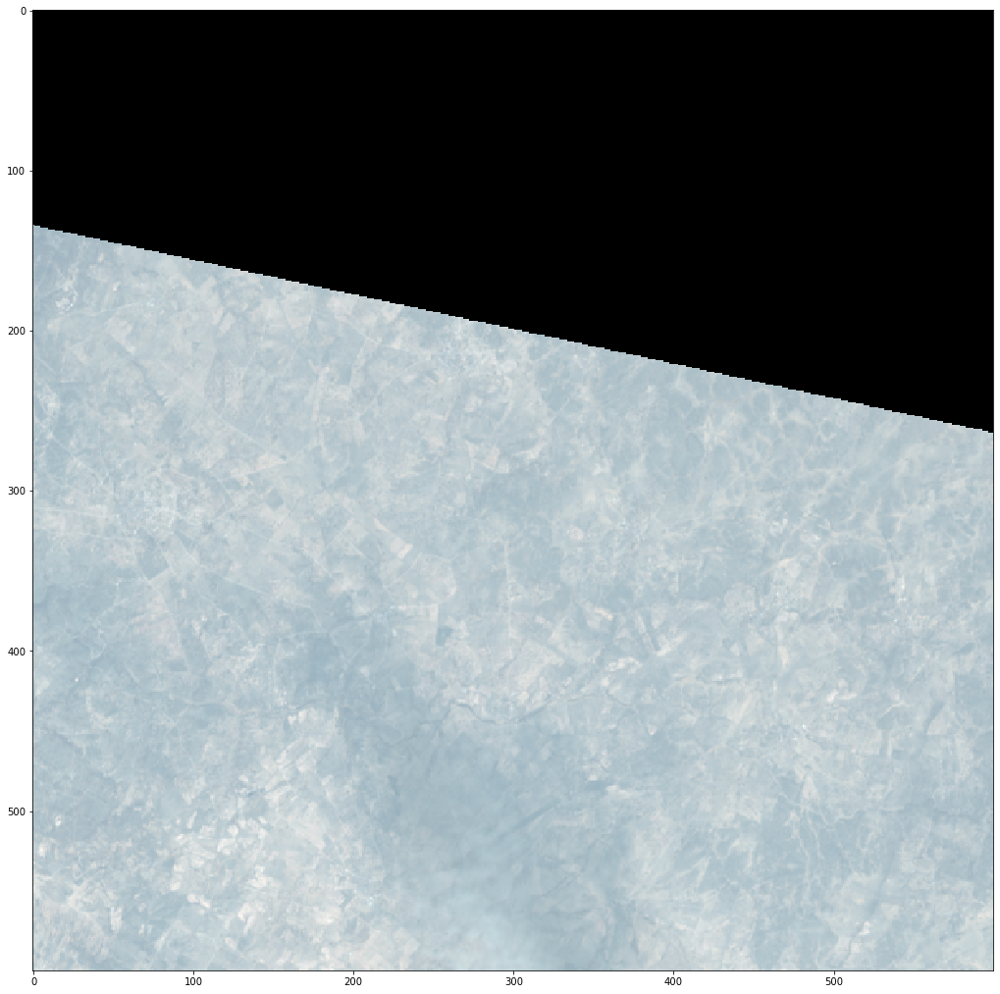



->>>>>>>>>>>>>>>>>> 3    LE07_L1TP_204032_20171013_20171109_01_T1       Image 28  of  39   

 
../../Satellite_img/3/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/3/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/3/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/3/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


5332 5932 4336 4936


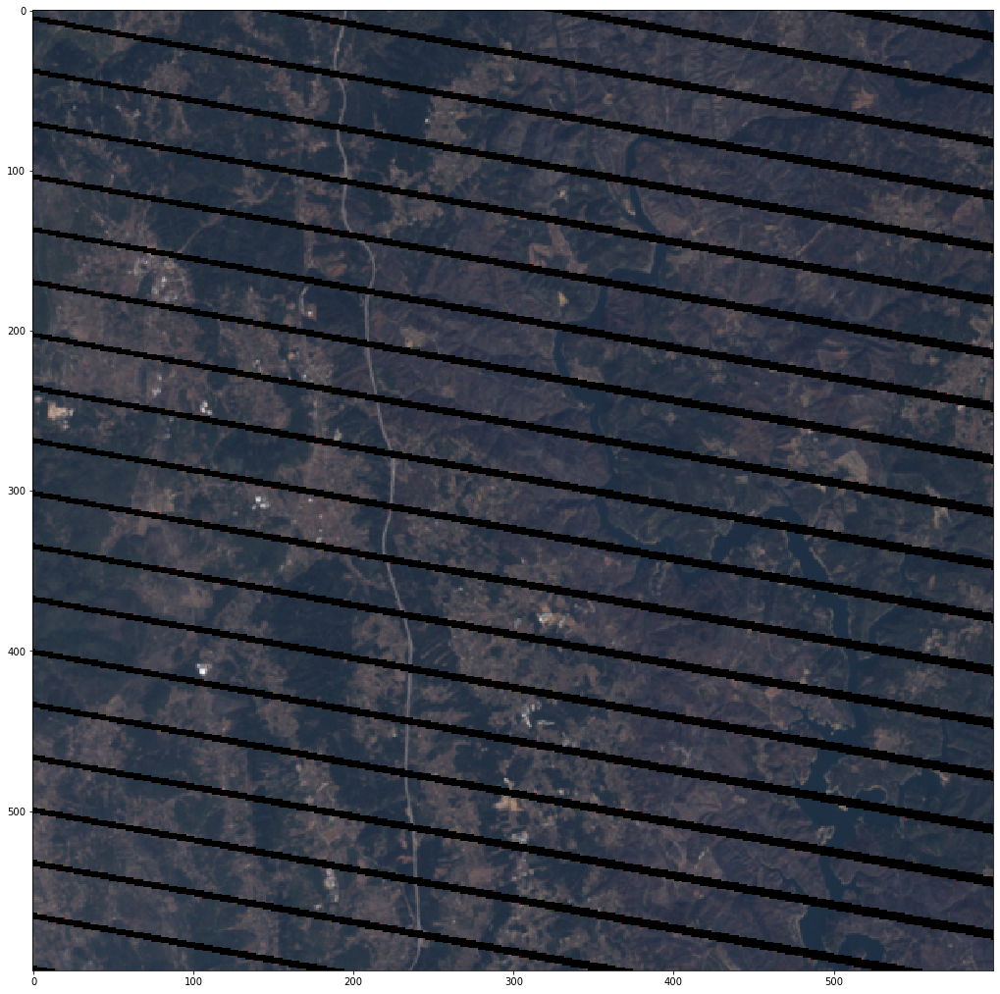



->>>>>>>>>>>>>>>>>> 4    LE07_L1TP_204032_20171013_20171109_01_T1       Image 29  of  39   

 
../../Satellite_img/4/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/4/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/4/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/4/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
2490 3090 5471 6071


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


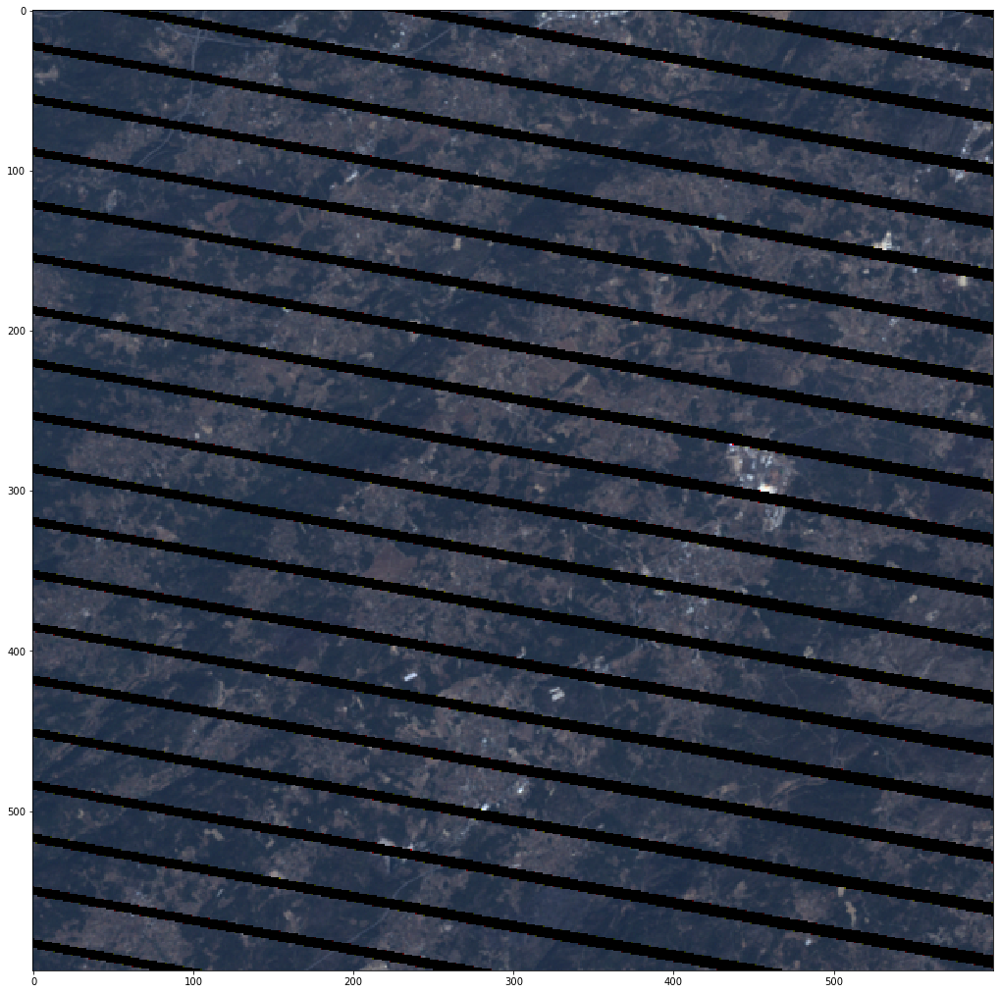



->>>>>>>>>>>>>>>>>> 5    LC08_L1TP_203032_20171014_20171024_01_T1       Image 30  of  39   

 
../../Satellite_img/5/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B1.TIF
../../Satellite_img/5/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B2.TIF
../../Satellite_img/5/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B3.TIF
../../Satellite_img/5/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7631, 'height': 7771, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 563085.0,
       0.0, -30.0, 4582815.0)}
1273 1873 3299 3899


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


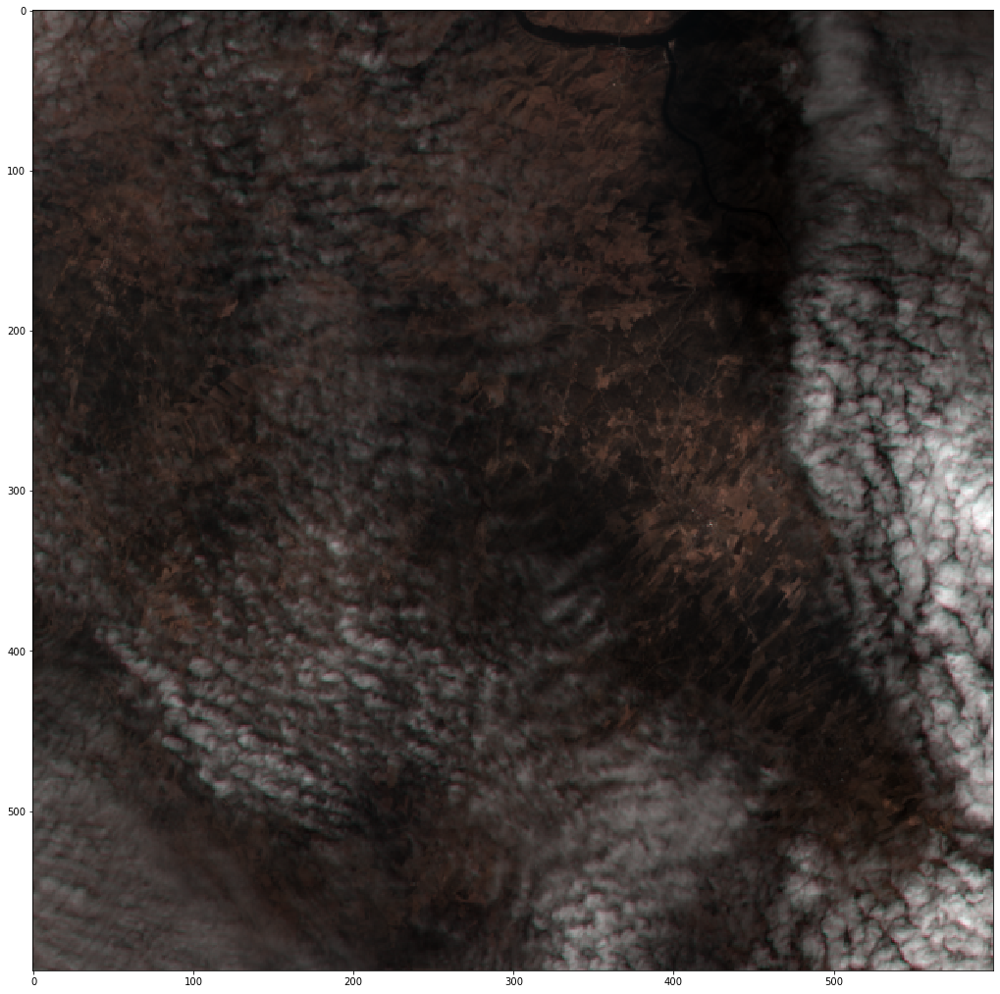



->>>>>>>>>>>>>>>>>> 5    LE07_L1TP_204032_20171013_20171109_01_T1       Image 31  of  39   

 
../../Satellite_img/5/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/5/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/5/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/5/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
6023 6623 2969 3569


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


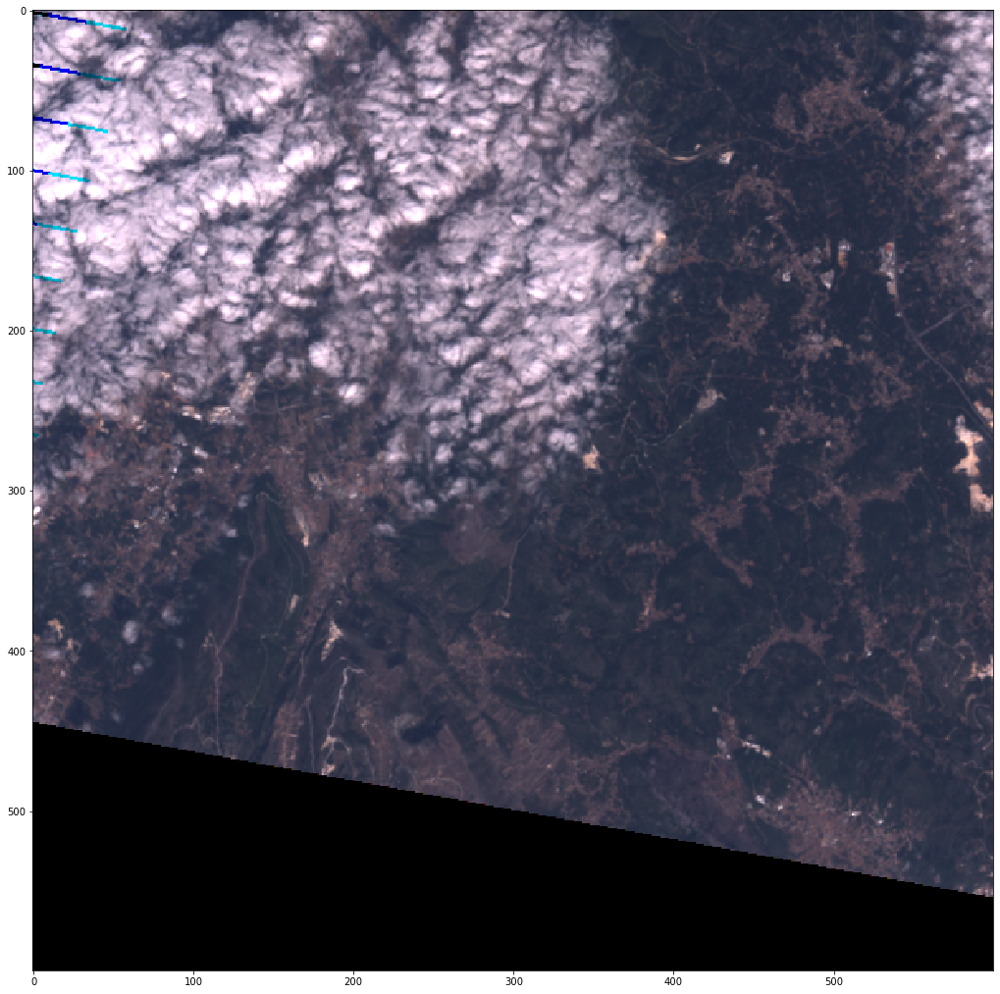



->>>>>>>>>>>>>>>>>> 6    LC08_L1TP_203032_20171014_20171024_01_T1       Image 32  of  39   

 
../../Satellite_img/6/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B1.TIF
../../Satellite_img/6/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B2.TIF
../../Satellite_img/6/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B3.TIF
../../Satellite_img/6/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7631, 'height': 7771, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 563085.0,
       0.0, -30.0, 4582815.0)}
804 1404 3039 3639


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


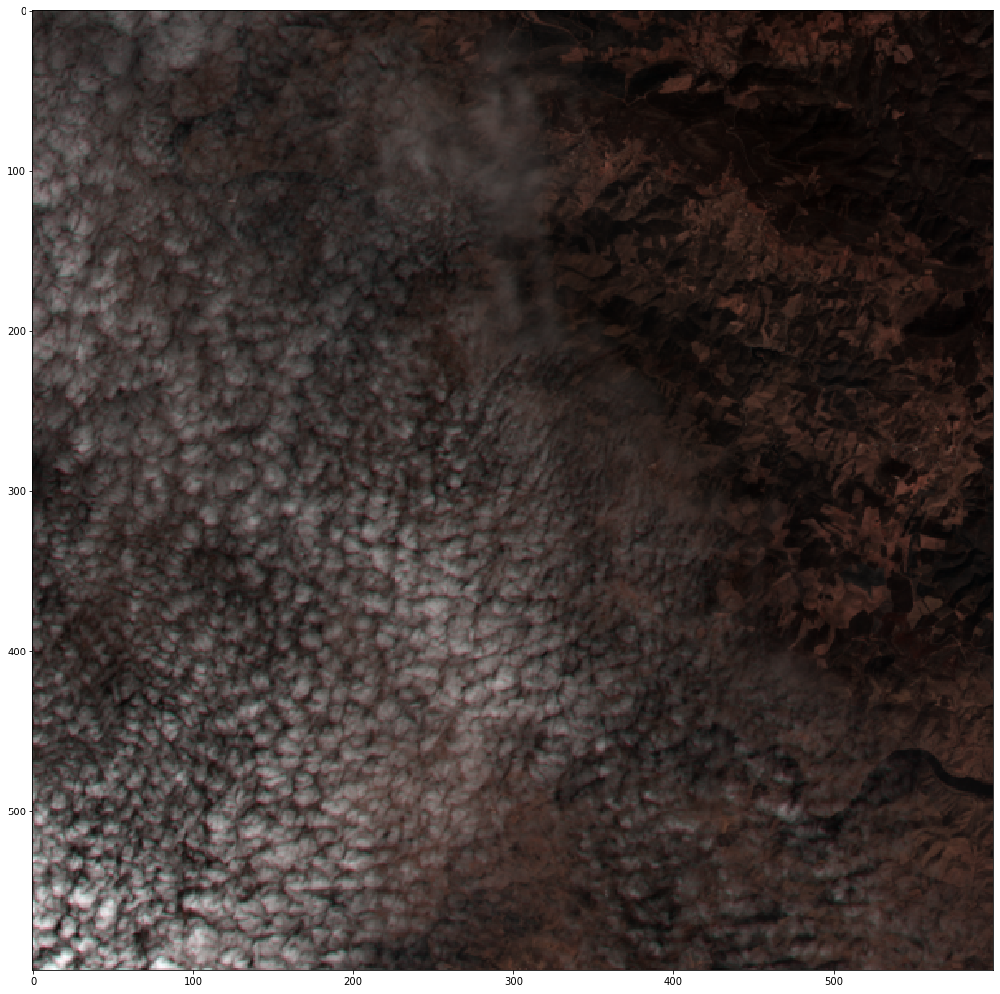



->>>>>>>>>>>>>>>>>> 6    LE07_L1TP_204032_20171013_20171109_01_T1       Image 33  of  39   

 
../../Satellite_img/6/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/6/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/6/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/6/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
5554 6154 2709 3309


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


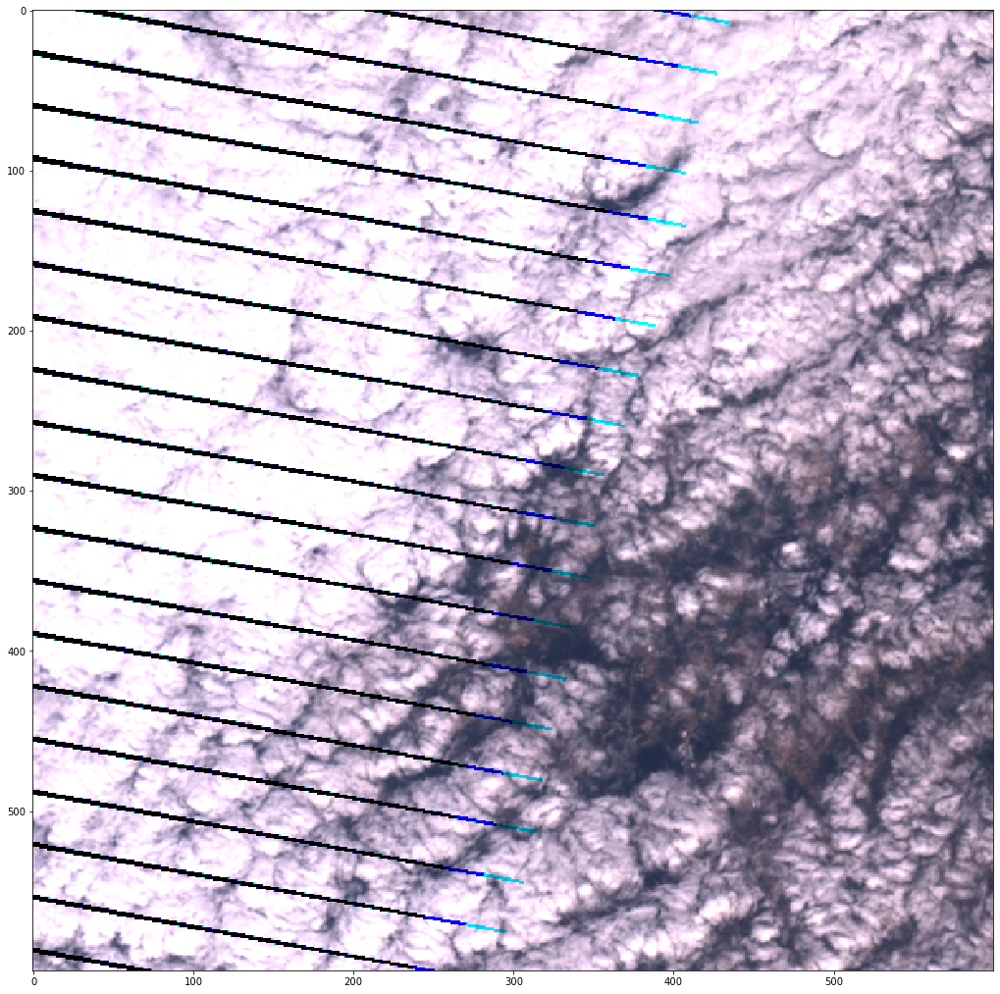



->>>>>>>>>>>>>>>>>> 7    LC08_L1TP_203032_20171014_20171024_01_T1       Image 34  of  39   

 
../../Satellite_img/7/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B1.TIF
../../Satellite_img/7/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B2.TIF
../../Satellite_img/7/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B3.TIF
../../Satellite_img/7/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7631, 'height': 7771, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 563085.0,
       0.0, -30.0, 4582815.0)}
1075 1675

C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


 2624 3224


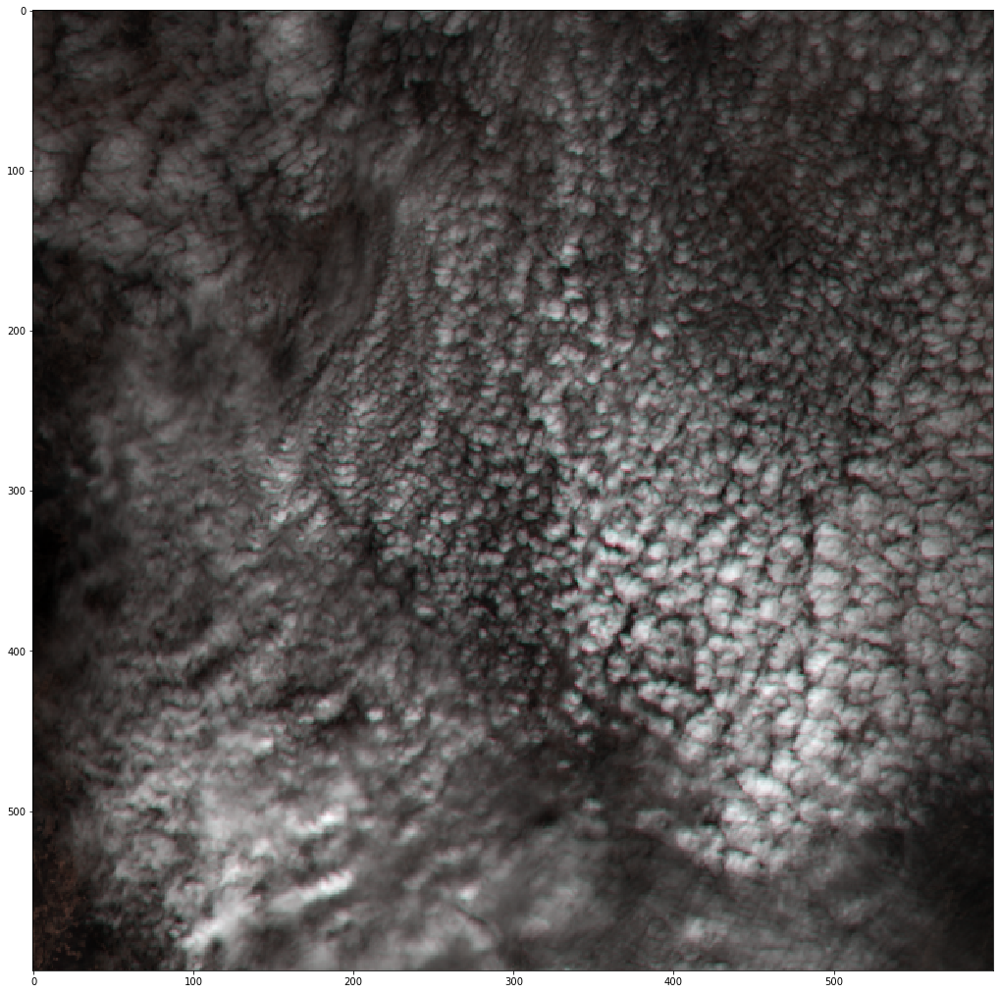



->>>>>>>>>>>>>>>>>> 7    LE07_L1TP_204032_20171013_20171109_01_T1       Image 35  of  39   

 
../../Satellite_img/7/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/7/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/7/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/7/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
5825 6425 2294 2894


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


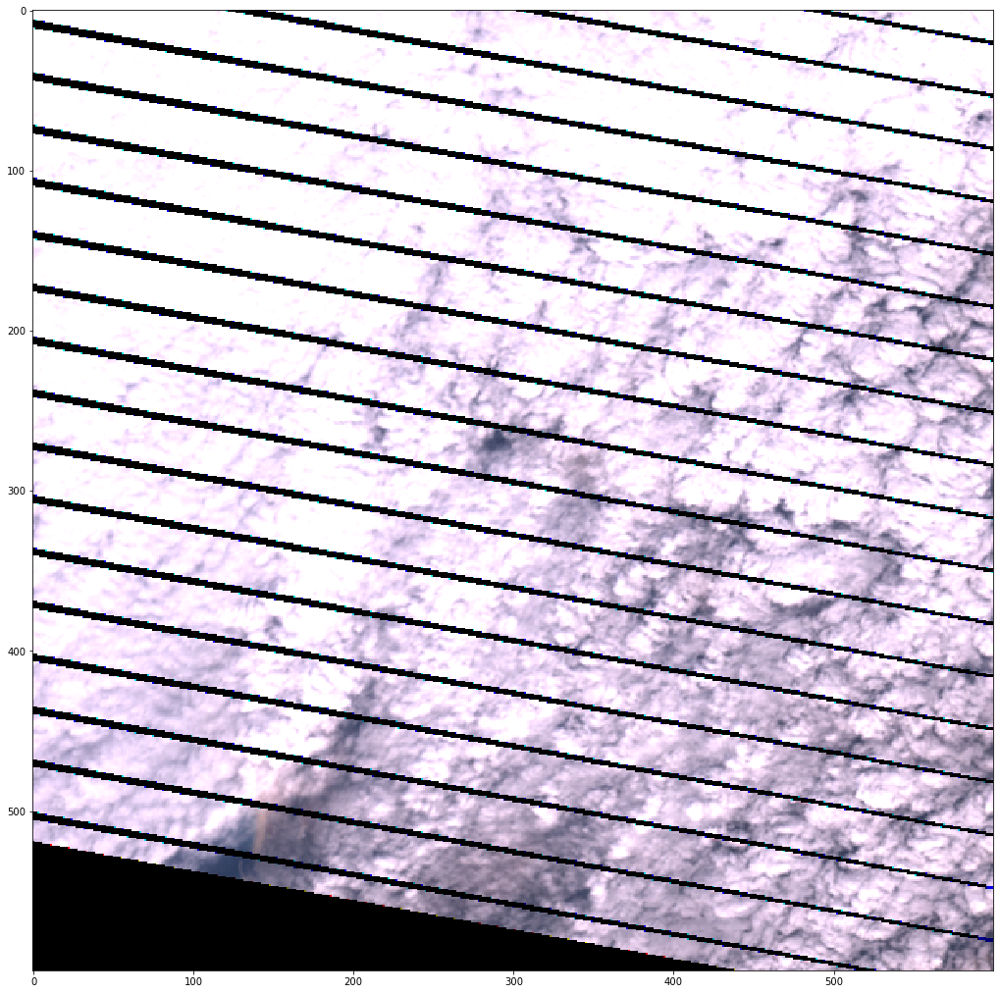



->>>>>>>>>>>>>>>>>> 8    LC08_L1TP_203032_20171014_20171024_01_T1       Image 36  of  39   

 
../../Satellite_img/8/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B1.TIF
../../Satellite_img/8/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B2.TIF
../../Satellite_img/8/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B3.TIF
../../Satellite_img/8/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7631, 'height': 7771, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 563085.0,
       0.0, -30.0, 4582815.0)}
1570 2170 3020 3620


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


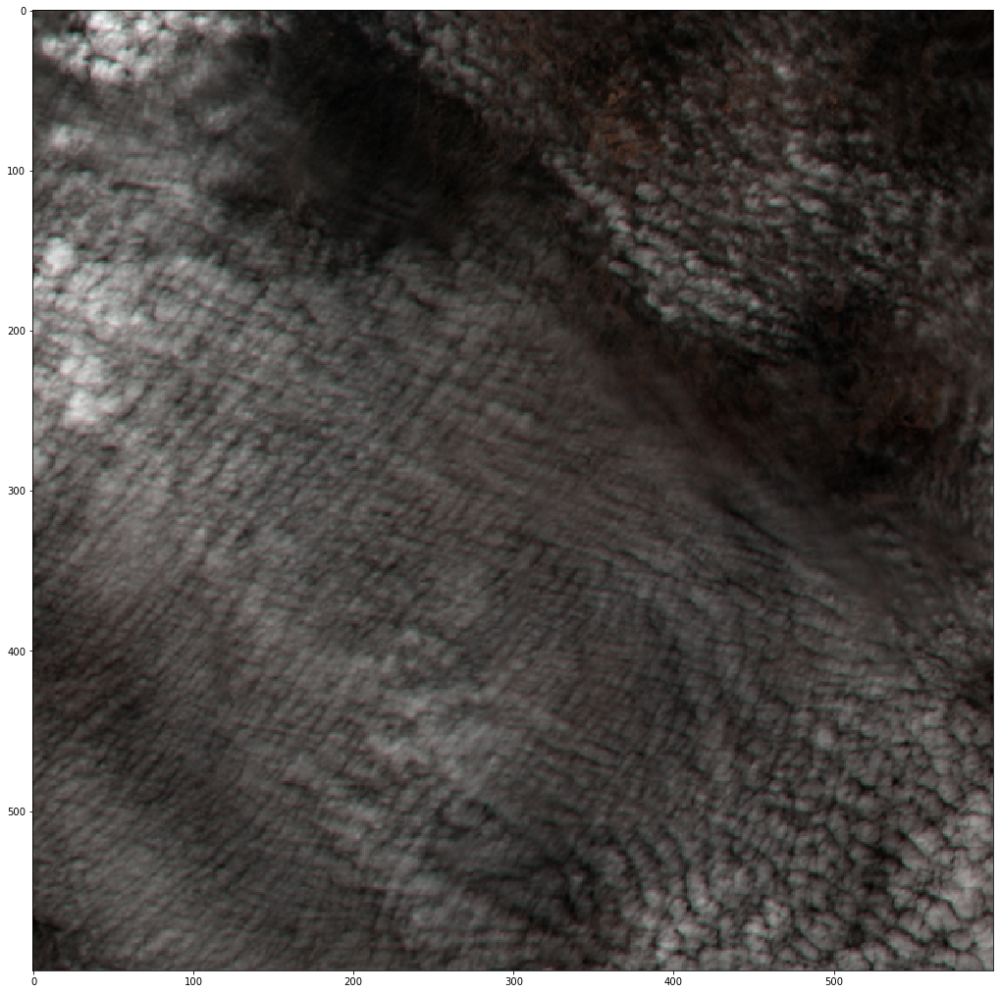



->>>>>>>>>>>>>>>>>> 8    LE07_L1TP_204032_20171013_20171109_01_T1       Image 37  of  39   

 
../../Satellite_img/8/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/8/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/8/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/8/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
6320 6920 2690 3290


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


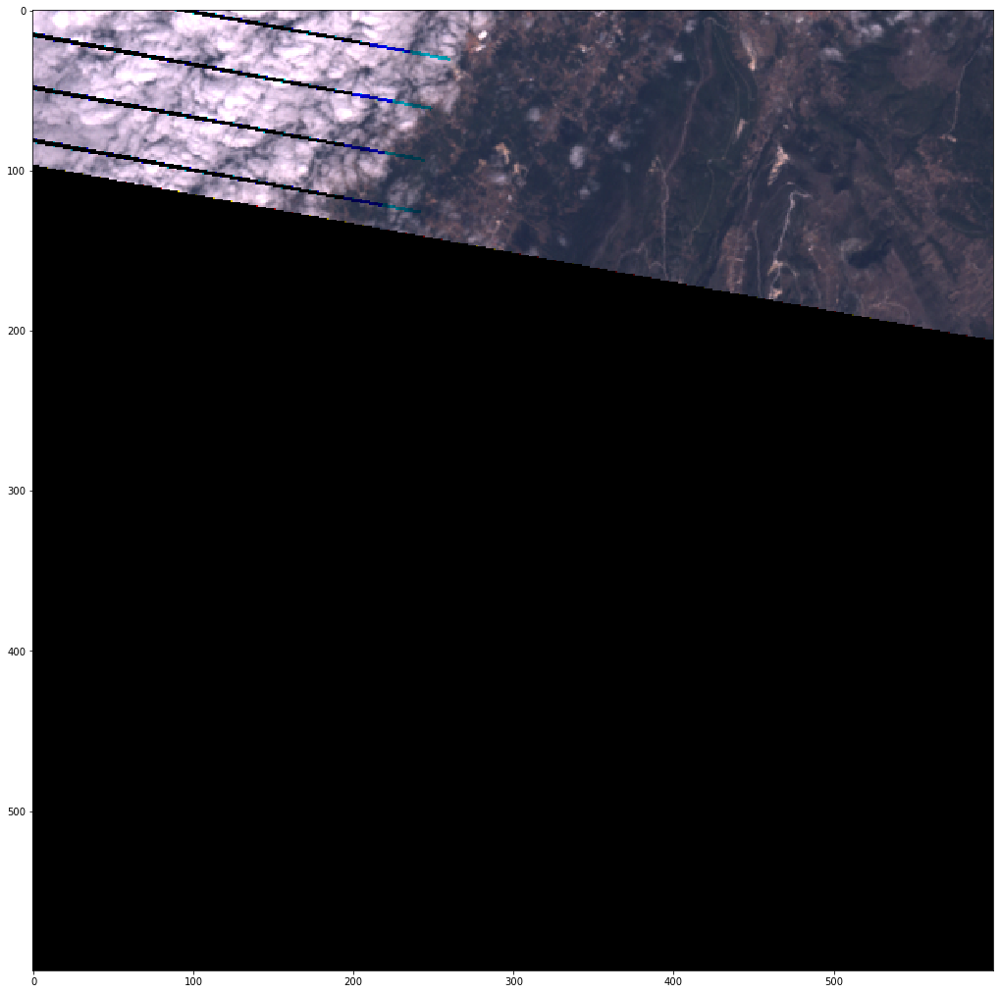



->>>>>>>>>>>>>>>>>> 9    LC08_L1TP_203032_20171014_20171024_01_T1       Image 38  of  39   

 
../../Satellite_img/9/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B1.TIF
../../Satellite_img/9/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B2.TIF
../../Satellite_img/9/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B3.TIF
../../Satellite_img/9/LC08_L1TP_203032_20171014_20171024_01_T1\LC08_L1TP_203032_20171014_20171024_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 7631, 'height': 7771, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 563085.0,
       0.0, -30.0, 4582815.0)}
819

C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


 1419 3514 4114


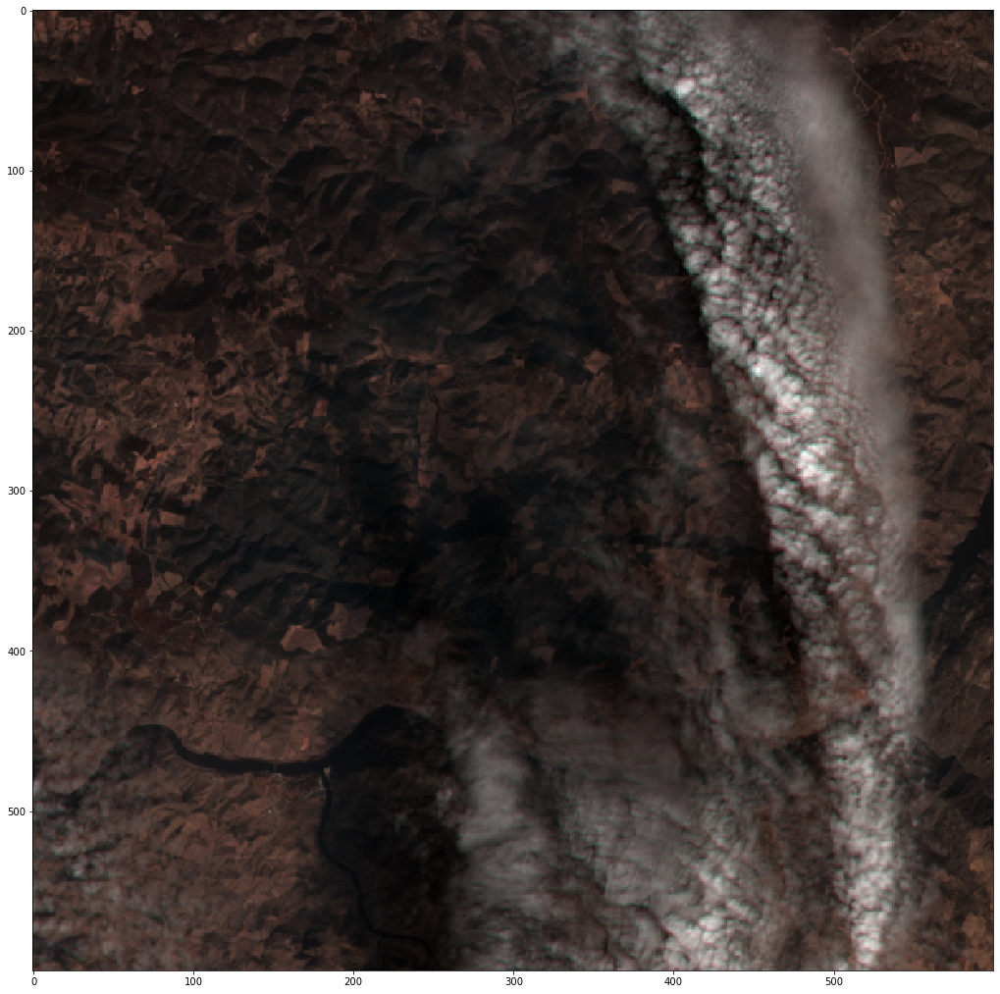



->>>>>>>>>>>>>>>>>> 9    LE07_L1TP_204032_20171013_20171109_01_T1       Image 39  of  39   

 
../../Satellite_img/9/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B1.TIF
../../Satellite_img/9/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B2.TIF
../../Satellite_img/9/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B3.TIF
../../Satellite_img/9/LE07_L1TP_204032_20171013_20171109_01_T1\LE07_L1TP_204032_20171013_20171109_01_T1_B4.TIF
META: {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 8161, 'height': 7171, 'count': 4, 'crs': CRS.from_epsg(32629), 'transform': Affine(30.0, 0.0, 420585.0,
       0.0, -30.0, 4572915.0)}
5569 6169 3184 3784


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


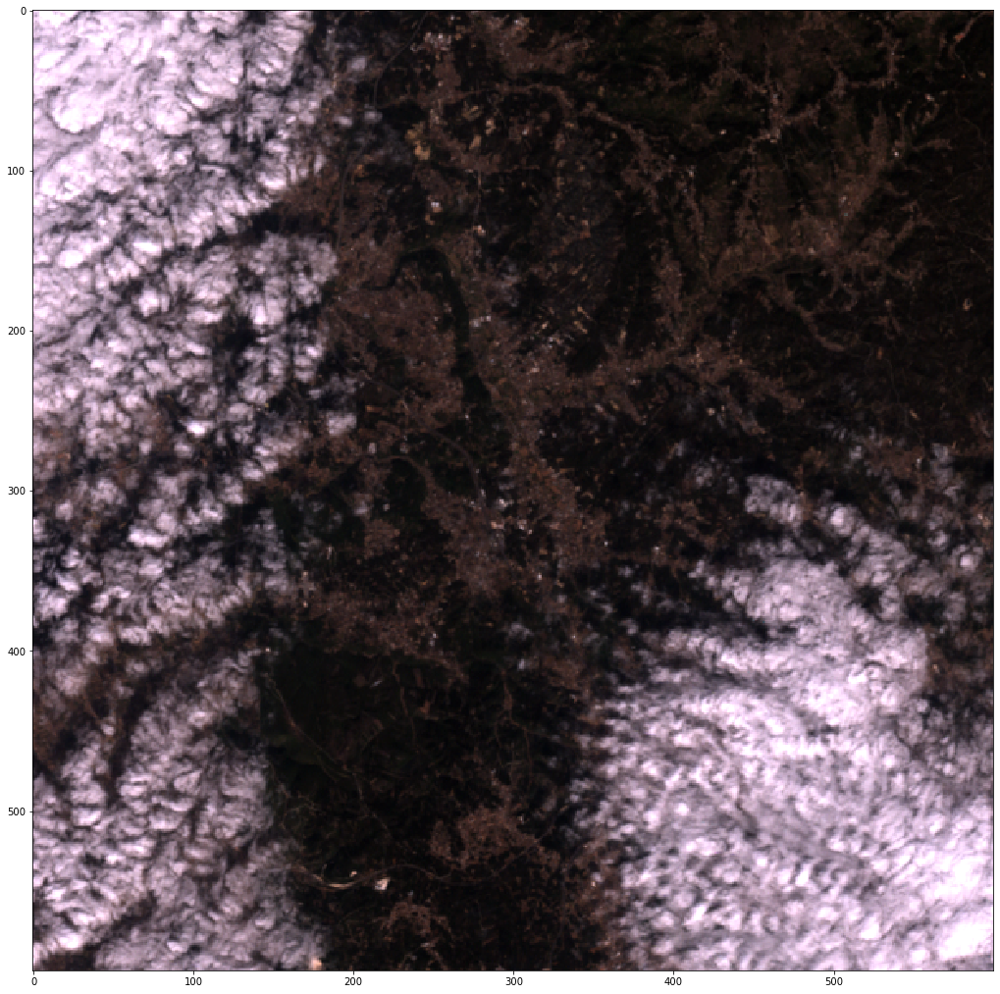

In [5]:
indexs = os.listdir("../../Satellite_img/")
n=0
for index in indexs :
    path = "../../Satellite_img/"+ index
    images_ids = os.listdir(path) # images founded for index choosen
    for image_id in images_ids :
        n= n + 1 
        print("\n\n->>>>>>>>>>>>>>>>>>", index,"  " ,image_id, "      Image", n ," of " , num_imgs ,"  \n\n " )
        lat = fires.loc[int(index)]["lat"]
        lon = fires.loc[int(index)]["lon"]
        si.image_true_color_landsat(index,image_id ,"../../Satellite_img/",lon,lat,300)
        